In [ ]:

#  Install Required Packages

!pip install osmnx folium networkx matplotlib numpy pandas geopandas shapely tqdm gtfs_kit pyproj contextily pyproj seaborn scikit-learn

#  Imports

import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import osmnx as ox
import geopandas as gpd
from shapely.geometry import Point, box
from tqdm import tqdm
import folium
import gtfs_kit as gk
import pyproj
import seaborn as sns
import contextily as ctx
from scipy.stats import gaussian_kde

#  Colab / Notebook Settings

ox.settings.use_cache = True
ox.settings.log_console = False
plt.style.use("seaborn-v0_8")

print(" All libraries successfully installed and imported.")


  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.5/101.5 kB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 2.7 MB/s eta 0:00:00
  Created wheel for json2html: filename=json2html-1.3.0-py3-none-any.whl size=7591 sha256=35f3c3a74f57b24042fa840a7b29ddb6a304462ba0305ca85fe77ef42ca01edc
  Stored in directory: /root/.cache/pip/wheels/91/96/d0/3cfff4cc9a9e307cfc2b8fe4846c56d714b78bbe5f6da211a5
Successfully built json2html
 All libraries successfully installed and imported.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Paths to GTFS directories

GTFS_BARCELONA_DIR  = "/content/drive/MyDrive/SNA_Project/Barcelona_gtfs/"
GTFS_MILAN_DIR = "/content/drive/MyDrive/SNA_Project/Milan_gtfs/"

def load_all_gtfs_tables(feed_dir):

    gtfs = {}
    txt_files = [f for f in os.listdir(feed_dir) if f.lower().endswith(".txt")]

    print(f"\nLoading GTFS from: {feed_dir}")
    print(f"Found {len(txt_files)} .txt files\n")

    for fname in sorted(txt_files):
        path = os.path.join(feed_dir, fname)
        key = fname[:-4]
        df = pd.read_csv(path, dtype=str, low_memory=False)

        gtfs[key] = df
        print(f"Loaded {key:25s} → shape = {df.shape}")

    return gtfs


# Load both feeds

gtfs_barcelona  = load_all_gtfs_tables(GTFS_BARCELONA_DIR)
gtfs_milan = load_all_gtfs_tables(GTFS_MILAN_DIR)

print("\nBarcelona tables:",  gtfs_barcelona.keys())
print("Milan tables:", gtfs_milan.keys())


Mounted at /content/drive

Loading GTFS from: /content/drive/MyDrive/SNA_Project/Barcelona_gtfs/
Found 10 .txt files

Loaded agency                    → shape = (1, 5)
Loaded calendar                  → shape = (2, 10)
Loaded calendar_dates            → shape = (26703, 3)
Loaded feed_info                 → shape = (1, 6)
Loaded routes                    → shape = (115, 7)
Loaded shapes                    → shape = (101578, 4)
Loaded stop_times                → shape = (1234269, 5)
Loaded stops                     → shape = (3441, 9)
Loaded transfers                 → shape = (60, 4)
Loaded trips                     → shape = (53216, 7)

Loading GTFS from: /content/drive/MyDrive/SNA_Project/Milan_gtfs/
Found 10 .txt files

Loaded agency                    → shape = (1, 7)
Loaded calendar                  → shape = (0, 10)
Loaded calendar_dates            → shape = (2469, 3)
Loaded feed_info                 → shape = (1, 7)
Loaded routes                    → shape = (165, 11)
Loaded shap

In [ ]:
def build_stop_graph(gtfs, city_name=""):

    required_tables = ["stops", "stop_times", "trips"]
    for t in required_tables:
        if t not in gtfs:
            raise ValueError(f"{city_name}: GTFS is missing required table: '{t}'")

    print(f"\n")
    print(f"Building Improved Stop Graph for {city_name}")
    print(f"\n")


    #  Get stops that are ACTUALLY USED in trips

    stops_with_trips = set(gtfs["stop_times"]["stop_id"].unique())
    print(f"\nUnique stop_ids in stop_times: {len(stops_with_trips):,}")


    # Filter stops table to only used stops

    stops = gtfs["stops"].copy()
    print(f"Original stops table: {len(stops):,} rows")

    # Filter to stops that appear in stop_times
    stops = stops[stops["stop_id"].isin(stops_with_trips)]
    print(f"After filtering to stops with trips: {len(stops):,} stops")


    #Check location_type distribution

    if 'location_type' in stops.columns:
        print(f"\nLocation type distribution (of stops with trips):")
        location_counts = stops['location_type'].fillna('0').value_counts().sort_index()
        for loc_type, count in location_counts.items():
            type_name = {
                '0': 'Stop/Platform',
                '1': 'Station (parent)',
                '2': 'Entrance/Exit',
                '3': 'Generic Node',
                '4': 'Boarding Area'
            }.get(str(loc_type), f'Unknown ({loc_type})')
            print(f"  location_type={loc_type}: {count:,} - {type_name}")

        #  Keep location_type 0, 1, and 4
        # Some feeds use parent stations (type 1) as actual boarding points
        stops['location_type'] = stops['location_type'].fillna('0')
        stops_before = len(stops)
        stops = stops[stops['location_type'].astype(str).isin(['0', '1', '4'])]
        stops_removed = stops_before - len(stops)

        if stops_removed > 0:
            print(f"\nRemoved {stops_removed:,} stops (entrances/exits/generic nodes)")
            print(f"Kept {len(stops):,} stops (platforms, stations, boarding areas)")
        else:
            print(f"\nKept all {len(stops):,} stops (no entrances/exits to remove)")
    else:
        print("\n  No location_type column - keeping all stops with trips")

    # Make sure basic columns exist
    for col in ["stop_id", "stop_lat", "stop_lon"]:
        if col not in stops.columns:
            raise ValueError(f"{city_name}: 'stops' table missing column '{col}'")

    # Keep only relevant columns
    keep_cols = [c for c in ["stop_id", "stop_name", "stop_lat", "stop_lon"] if c in stops.columns]
    stops = stops[keep_cols].drop_duplicates(subset=["stop_id"])

    print(f"\nFinal filtered stops: {len(stops):,}")


    #Prepare stop_times table

    stop_times = gtfs["stop_times"].copy()

    for col in ["trip_id", "stop_id", "stop_sequence"]:
        if col not in stop_times.columns:
            raise ValueError(f"{city_name}: 'stop_times' table missing column '{col}'")

    # Filter stop_times to only include our filtered stops
    stop_times = stop_times[stop_times["stop_id"].isin(stops["stop_id"])]
    print(f"Stop_times entries after filtering: {len(stop_times):,}")

    # Convert stop_sequence to integer
    stop_times["stop_sequence"] = pd.to_numeric(stop_times["stop_sequence"], errors="coerce")
    stop_times = stop_times.dropna(subset=["stop_sequence"])
    stop_times["stop_sequence"] = stop_times["stop_sequence"].astype(int)


    stop_times = stop_times.sort_values(["trip_id", "stop_sequence"])


    #Create consecutive stop pairs per trip

    stop_times["next_stop_id"] = stop_times.groupby("trip_id")["stop_id"].shift(-1)

    edges_df = stop_times.dropna(subset=["next_stop_id"])[["stop_id", "next_stop_id"]].copy()
    edges_df.rename(columns={"stop_id": "u", "next_stop_id": "v"}, inplace=True)

    # Edge weight = number of times this (u, v) pair appears
    edges_agg = (
        edges_df
        .groupby(["u", "v"])
        .size()
        .reset_index(name="weight")
    )


    #Build directed graph

    G = nx.DiGraph()


    for _, row in stops.iterrows():
        node_id = row["stop_id"]
        attrs = row.to_dict()
        G.add_node(node_id, **attrs)


    for _, row in edges_agg.iterrows():
        u = row["u"]
        v = row["v"]
        w = int(row["weight"])
        G.add_edge(u, v, weight=w)


    #Enhanced statistics


    print(f"{city_name} - Improved Stop Graph Statistics")
    print(f"{'='*40}")
    print(f"Nodes (actual stops):              {G.number_of_nodes():,}")
    print(f"Edges (directed connections):      {G.number_of_edges():,}")

    if G.number_of_nodes() > 0:
        edge_node_ratio = G.number_of_edges() / G.number_of_nodes()
        print(f"Edge-to-Node ratio:                {edge_node_ratio:.2f}")

        if edge_node_ratio < 1.0:
            print(f"    WARNING: Ratio < 1.0 suggests disconnected network")
        elif edge_node_ratio < 1.5:
            print(f"    Low ratio - network may be sparse")
        else:
            print(f"   Good ratio - network is well-connected")

        # Average degree
        avg_degree = sum(dict(G.degree()).values()) / G.number_of_nodes()
        print(f"Average degree:                    {avg_degree:.2f}")

    # Density
    density = nx.density(G)
    print(f"Network density:                   {density:.6f}")

    # Connected components
    try:
        n_weak = nx.number_weakly_connected_components(G)
        n_strong = nx.number_strongly_connected_components(G)
        print(f"Weakly connected components:       {n_weak:,}")
        print(f"Strongly connected components:     {n_strong:,}")

        # Largest component info
        largest_wcc = max(nx.weakly_connected_components(G), key=len)
        largest_wcc_size = len(largest_wcc)
        largest_wcc_pct = (largest_wcc_size / G.number_of_nodes()) * 100
        print(f"Largest component size:            {largest_wcc_size:,} ({largest_wcc_pct:.1f}%)")

        if largest_wcc_pct < 50:
            print(f"    WARNING: Largest component < 50% - very fragmented network")
        elif largest_wcc_pct < 70:
            print(f"    Largest component < 70% - somewhat fragmented")
        else:
            print(f"   Largest component > 70% - well-connected network")

    except Exception as e:
        print(f"Could not compute connectivity: {e}")


    return G



# Build graphs for Barcelona & Milan


print("BUILDING IMPROVED GRAPHS (includes parent stations if used)")


G_barcelona_improved = build_stop_graph(gtfs_barcelona, city_name="Barcelona")
G_milan_improved = build_stop_graph(gtfs_milan, city_name="Milan")

# Update the global variables
G_barcelona = G_barcelona_improved
G_milan = G_milan_improved

print("\n Improved graphs built successfully!")



BUILDING IMPROVED GRAPHS (includes parent stations if used)


Building Improved Stop Graph for Barcelona



Unique stop_ids in stop_times: 2,771
Original stops table: 3,441 rows
After filtering to stops with trips: 2,771 stops

Location type distribution (of stops with trips):
  location_type=0: 2,771 - Stop/Platform

Kept all 2,771 stops (no entrances/exits to remove)

Final filtered stops: 2,771
Stop_times entries after filtering: 1,234,269
Barcelona - Improved Stop Graph Statistics
Nodes (actual stops):              2,771
Edges (directed connections):      3,584
Edge-to-Node ratio:                1.29
    Low ratio - network may be sparse
Average degree:                    2.59
Network density:                   0.000467
Weakly connected components:       12
Strongly connected components:     34
Largest component size:            2,492 (89.9%)
   Largest component > 70% - well-connected network


Building Improved Stop Graph for Milan



Unique stop_ids in stop_times: 4,913
Original

In [ ]:
def build_stop_graph(gtfs, city_name=""):

    required_tables = ["stops", "stop_times", "trips"]
    for t in required_tables:
        if t not in gtfs:
            raise ValueError(f"{city_name}: GTFS is missing required table: '{t}'")

    print(f"\n")
    print(f"Building Improved Stop Graph for {city_name}")
    print(f"\n")


    #  Get stops that are ACTUALLY USED in trips

    stops_with_trips = set(gtfs["stop_times"]["stop_id"].unique())
    print(f"\nUnique stop_ids in stop_times: {len(stops_with_trips):,}")


    # Filter stops table to only used stops

    stops = gtfs["stops"].copy()
    print(f"Original stops table: {len(stops):,} rows")

    # Filter to stops that appear in stop_times
    stops = stops[stops["stop_id"].isin(stops_with_trips)]
    print(f"After filtering to stops with trips: {len(stops):,} stops")


    #Check location_type distribution

    if 'location_type' in stops.columns:
        print(f"\nLocation type distribution (of stops with trips):")
        location_counts = stops['location_type'].fillna('0').value_counts().sort_index()
        for loc_type, count in location_counts.items():
            type_name = {
                '0': 'Stop/Platform',
                '1': 'Station (parent)',
                '2': 'Entrance/Exit',
                '3': 'Generic Node',
                '4': 'Boarding Area'
            }.get(str(loc_type), f'Unknown ({loc_type})')
            print(f"  location_type={loc_type}: {count:,} - {type_name}")

        #  Keep location_type 0, 1, and 4
        # Some feeds use parent stations (type 1) as actual boarding points
        stops['location_type'] = stops['location_type'].fillna('0')
        stops_before = len(stops)
        stops = stops[stops['location_type'].astype(str).isin(['0', '1', '4'])]
        stops_removed = stops_before - len(stops)

        if stops_removed > 0:
            print(f"\nRemoved {stops_removed:,} stops (entrances/exits/generic nodes)")
            print(f"Kept {len(stops):,} stops (platforms, stations, boarding areas)")
        else:
            print(f"\nKept all {len(stops):,} stops (no entrances/exits to remove)")
    else:
        print("\n  No location_type column - keeping all stops with trips")

    # Make sure basic columns exist
    for col in ["stop_id", "stop_lat", "stop_lon"]:
        if col not in stops.columns:
            raise ValueError(f"{city_name}: 'stops' table missing column '{col}'")

    # Keep only relevant columns
    keep_cols = [c for c in ["stop_id", "stop_name", "stop_lat", "stop_lon"] if c in stops.columns]
    stops = stops[keep_cols].drop_duplicates(subset=["stop_id"])

    print(f"\nFinal filtered stops: {len(stops):,}")


    #Prepare stop_times table

    stop_times = gtfs["stop_times"].copy()

    for col in ["trip_id", "stop_id", "stop_sequence"]:
        if col not in stop_times.columns:
            raise ValueError(f"{city_name}: 'stop_times' table missing column '{col}'")

    # Filter stop_times to only include our filtered stops
    stop_times = stop_times[stop_times["stop_id"].isin(stops["stop_id"])]
    print(f"Stop_times entries after filtering: {len(stop_times):,}")

    # Convert stop_sequence to integer
    stop_times["stop_sequence"] = pd.to_numeric(stop_times["stop_sequence"], errors="coerce")
    stop_times = stop_times.dropna(subset=["stop_sequence"])
    stop_times["stop_sequence"] = stop_times["stop_sequence"].astype(int)


    stop_times = stop_times.sort_values(["trip_id", "stop_sequence"])


    #Create consecutive stop pairs per trip

    stop_times["next_stop_id"] = stop_times.groupby("trip_id")["stop_id"].shift(-1)

    edges_df = stop_times.dropna(subset=["next_stop_id"])[["stop_id", "next_stop_id"]].copy()
    edges_df.rename(columns={"stop_id": "u", "next_stop_id": "v"}, inplace=True)

    # Edge weight = number of times this (u, v) pair appears
    edges_agg = (
        edges_df
        .groupby(["u", "v"])
        .size()
        .reset_index(name="weight")
    )


    #Build directed graph

    G = nx.DiGraph()


    for _, row in stops.iterrows():
        node_id = row["stop_id"]
        attrs = row.to_dict()
        G.add_node(node_id, **attrs)


    for _, row in edges_agg.iterrows():
        u = row["u"]
        v = row["v"]
        w = int(row["weight"])
        G.add_edge(u, v, weight=w)


    #Enhanced statistics


    print(f"{city_name} - Improved Stop Graph Statistics")
    print(f"{'='*40}")
    print(f"Nodes (actual stops):              {G.number_of_nodes():,}")
    print(f"Edges (directed connections):      {G.number_of_edges():,}")

    if G.number_of_nodes() > 0:
        edge_node_ratio = G.number_of_edges() / G.number_of_nodes()
        print(f"Edge-to-Node ratio:                {edge_node_ratio:.2f}")

        if edge_node_ratio < 1.0:
            print(f"    WARNING: Ratio < 1.0 suggests disconnected network")
        elif edge_node_ratio < 1.5:
            print(f"    Low ratio - network may be sparse")
        else:
            print(f"   Good ratio - network is well-connected")

        # Average degree
        avg_degree = sum(dict(G.degree()).values()) / G.number_of_nodes()
        print(f"Average degree:                    {avg_degree:.2f}")

    # Density
    density = nx.density(G)
    print(f"Network density:                   {density:.6f}")

    # Connected components
    try:
        n_weak = nx.number_weakly_connected_components(G)
        n_strong = nx.number_strongly_connected_components(G)
        print(f"Weakly connected components:       {n_weak:,}")
        print(f"Strongly connected components:     {n_strong:,}")

        # Largest component info
        largest_wcc = max(nx.weakly_connected_components(G), key=len)
        largest_wcc_size = len(largest_wcc)
        largest_wcc_pct = (largest_wcc_size / G.number_of_nodes()) * 100
        print(f"Largest component size:            {largest_wcc_size:,} ({largest_wcc_pct:.1f}%)")

        if largest_wcc_pct < 50:
            print(f"    WARNING: Largest component < 50% - very fragmented network")
        elif largest_wcc_pct < 70:
            print(f"    Largest component < 70% - somewhat fragmented")
        else:
            print(f"   Largest component > 70% - well-connected network")

    except Exception as e:
        print(f"Could not compute connectivity: {e}")


    return G



# Build graphs for Barcelona & Milan


print("BUILDING IMPROVED GRAPHS (includes parent stations if used)")


G_barcelona_improved = build_stop_graph(gtfs_barcelona, city_name="Barcelona")
G_milan_improved = build_stop_graph(gtfs_milan, city_name="Milan")

# Update the global variables
G_barcelona = G_barcelona_improved
G_milan = G_milan_improved

print("\n Improved graphs built successfully!")



BUILDING IMPROVED GRAPHS (includes parent stations if used)


Building Improved Stop Graph for Barcelona



Unique stop_ids in stop_times: 2,771
Original stops table: 3,441 rows
After filtering to stops with trips: 2,771 stops

Location type distribution (of stops with trips):
  location_type=0: 2,771 - Stop/Platform

Kept all 2,771 stops (no entrances/exits to remove)

Final filtered stops: 2,771
Stop_times entries after filtering: 1,234,269
Barcelona - Improved Stop Graph Statistics
Nodes (actual stops):              2,771
Edges (directed connections):      3,584
Edge-to-Node ratio:                1.29
    Low ratio - network may be sparse
Average degree:                    2.59
Network density:                   0.000467
Weakly connected components:       12
Strongly connected components:     34
Largest component size:            2,492 (89.9%)
   Largest component > 70% - well-connected network


Building Improved Stop Graph for Milan



Unique stop_ids in stop_times: 4,913
Original

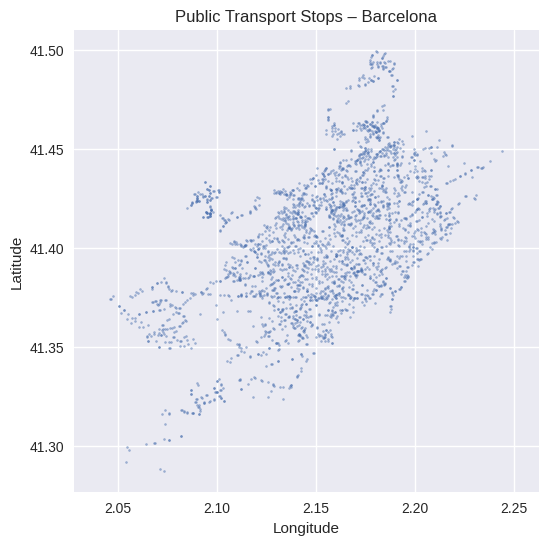

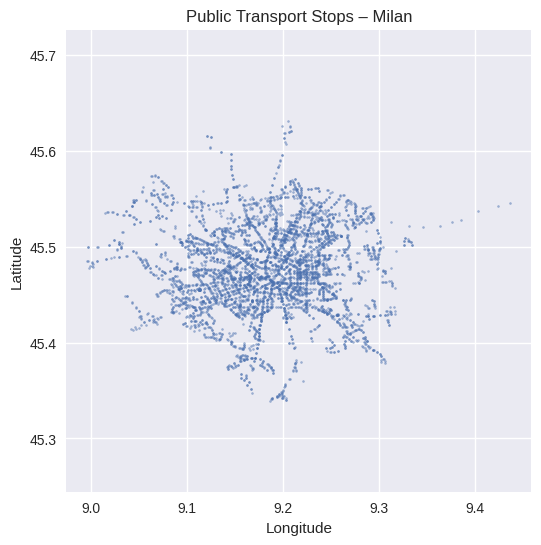

In [ ]:
def plot_stop_scatter(G, city_name="", point_size=2):
    """
    Quick scatter plot of all stops in a GTFS-based graph.
    Uses stop_lon (x) and stop_lat (y) from node attributes.
    """
    lats = []
    lons = []

    for n, data in G.nodes(data=True):
        lat = data.get("stop_lat", None)
        lon = data.get("stop_lon", None)
        if lat is None or lon is None:
            continue

        try:
            lat = float(lat)
            lon = float(lon)
        except ValueError:
            continue

        lats.append(lat)
        lons.append(lon)

    if not lats:
        print(f"No valid coordinates found for {city_name}.")
        return

    plt.figure(figsize=(6, 6))
    plt.scatter(lons, lats, s=point_size, alpha=0.5)
    plt.title(f"Public Transport Stops – {city_name}")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.axis("equal")
    plt.grid(True)
    plt.show()



# Plot both cities

plot_stop_scatter(G_barcelona,  city_name="Barcelona",  point_size=2)
plot_stop_scatter(G_milan, city_name="Milan", point_size=2)


# Degree Centrality

## Degree Measures for Barcelana & Milan

In [ ]:
# where to store shapefiles
SAVE_DIR = "/content/drive/MyDrive/SNA_Project/shapefiles/"
os.makedirs(SAVE_DIR, exist_ok=True)



# 1. Barcelona boundary


barcelona_minx, barcelona_miny = 2.05, 41.32
barcelona_maxx, barcelona_maxy = 2.23, 41.47

barcelona_poly = box(barcelona_minx, barcelona_miny, barcelona_maxx, barcelona_maxy)

barcelona_gdf = gpd.GeoDataFrame(
    {"name": ["Barcelona"]},
    geometry=[barcelona_poly],
    crs="EPSG:4326"
)

barcelona_path = os.path.join(SAVE_DIR, "barcelona_boundary.shp")
barcelona_gdf.to_file(barcelona_path)
print(" Barcelona boundary shapefile saved to:", barcelona_path)



# 2. Milan boundary


milan_minx, milan_miny = 9.00, 45.39
milan_maxx, milan_maxy = 9.32, 45.56

milan_poly = box(milan_minx, milan_miny, milan_maxx, milan_maxy)

milan_gdf = gpd.GeoDataFrame(
    {"name": ["Milan"]},
    geometry=[milan_poly],
    crs="EPSG:4326"
)

milan_path = os.path.join(SAVE_DIR, "milan_boundary.shp")
milan_gdf.to_file(milan_path)
print(" Milan boundary shapefile saved to:", milan_path)


 Barcelona boundary shapefile saved to: /content/drive/MyDrive/SNA_Project/shapefiles/barcelona_boundary.shp
 Milan boundary shapefile saved to: /content/drive/MyDrive/SNA_Project/shapefiles/milan_boundary.shp


In [ ]:

# DEGREE CENTRALITY – BARCELONA & MILAN


#Degree measures (raw & centralities)


def compute_degree_measures(G, city_name=""):


    deg_in = dict(G.in_degree())
    deg_out = dict(G.out_degree())
    deg_total = dict(G.degree())

    # Degree centralities (normalized)
    in_deg_centrality = nx.in_degree_centrality(G)
    out_deg_centrality = nx.out_degree_centrality(G)

    # For standard degree_centrality, use an undirected view
    G_und = G.to_undirected()
    deg_centrality_undirected = nx.degree_centrality(G_und)

    #Build DataFrame
    rows = []
    for node, data in G.nodes(data=True):
        row = {
            "stop_id": node,
            "stop_name": data.get("stop_name", None),
            "stop_lat": float(data.get("stop_lat")) if data.get("stop_lat") is not None else np.nan,
            "stop_lon": float(data.get("stop_lon")) if data.get("stop_lon") is not None else np.nan,
            "deg_in": deg_in.get(node, 0),
            "deg_out": deg_out.get(node, 0),
            "deg_total": deg_total.get(node, 0),
            "in_deg_centrality": in_deg_centrality.get(node, 0.0),
            "out_deg_centrality": out_deg_centrality.get(node, 0.0),
            "deg_centrality_undirected": deg_centrality_undirected.get(node, 0.0),
        }
        rows.append(row)

    df = pd.DataFrame(rows).set_index("stop_id")

    #Attach as node attributes for later use
    nx.set_node_attributes(G, deg_in, name="deg_in")
    nx.set_node_attributes(G, deg_out, name="deg_out")
    nx.set_node_attributes(G, deg_total, name="deg_total")
    nx.set_node_attributes(G, in_deg_centrality, name="in_deg_centrality")
    nx.set_node_attributes(G, out_deg_centrality, name="out_deg_centrality")
    nx.set_node_attributes(G, deg_centrality_undirected, name="deg_centrality_undirected")

    #Basic summary
    print(f"\n=== Degree summary for {city_name} ===")
    print(df[["deg_in", "deg_out", "deg_total"]].describe().round(2))

    # Top 10 most connected stops by total degree
    top10 = df.sort_values("deg_total", ascending=False).head(10)
    print(f"\nTop 10 stops by total degree in {city_name}:")
    display(top10[["stop_name", "deg_in", "deg_out", "deg_total"]])

    return df


def add_weighted_degree(G, df_deg, city_name=""):

    # raw weighted degree from the DiGraph
    w_deg = dict(G.degree(weight="weight"))
    max_deg = max(w_deg.values()) if w_deg else 1

    w_deg_centrality = {n: d / max_deg for n, d in w_deg.items()}

    # write into graph
    nx.set_node_attributes(G, w_deg, name="weighted_degree")
    nx.set_node_attributes(G, w_deg_centrality, name="weighted_degree_centrality")

    # add to DataFrame
    df_deg = df_deg.copy()
    df_deg["weighted_degree"] = pd.Series(w_deg)
    df_deg["weighted_degree_centrality"] = pd.Series(w_deg_centrality)

    print(f"{city_name}: added weighted_degree and weighted_degree_centrality.")
    return df_deg


# Compute degree tables for both cities
deg_barcelona = compute_degree_measures(G_barcelona, city_name="Barcelona")
deg_barcelona = add_weighted_degree(G_barcelona, deg_barcelona, city_name="Barcelona")

deg_milan = compute_degree_measures(G_milan, city_name="Milan")
deg_milan = add_weighted_degree(G_milan, deg_milan, city_name="Milan")



=== Degree summary for Barcelona ===
        deg_in  deg_out  deg_total
count  2771.00  2771.00    2771.00
mean      1.29     1.29       2.59
std       0.59     0.58       1.02
min       0.00     0.00       1.00
25%       1.00     1.00       2.00
50%       1.00     1.00       2.00
75%       1.00     1.00       3.00
max       6.00     6.00      12.00

Top 10 stops by total degree in Barcelona:


,stop_name,deg_in,deg_out,deg_total
stop_id,,,,
2.3935.700096,Paral·lel - Pl Espanya,6,6,12
2.3404.691452,Av dels Quinze - Serrano,4,5,9
2.108.698907,Pl Espanya - FGC,6,2,8
2.9951.700270,"Pg. Sant Antoni, 53-55",4,4,8
2.1914.675960,Foc - Mare de Déu de Port,4,4,8
2.875.688152,Escòcia,3,4,7
2.21.674475,Palau Reial,3,4,7
2.1124.697162,Ronda Universitat - Pl Universitat,4,3,7
2.9392.691929,"Av. Meridiana, 277",3,4,7


Barcelona: added weighted_degree and weighted_degree_centrality.

=== Degree summary for Milan ===
        deg_in  deg_out  deg_total
count  4913.00  4913.00    4913.00
mean      1.25     1.25       2.49
std       0.54     0.55       0.96
min       0.00     0.00       1.00
25%       1.00     1.00       2.00
50%       1.00     1.00       2.00
75%       1.00     1.00       3.00
max       7.00     9.00      16.00

Top 10 stops by total degree in Milan:


,stop_name,deg_in,deg_out,deg_total
stop_id,,,,
13312,comasina m3,7,9,16
20056,diaz,4,8,12
12709,stazione lambrate m2,5,6,11
11930,stazione centrale via tonale,4,6,10
12211,loreto m1 m2,4,5,9
13129,molino dorino m1,5,4,9
16723,stazione lambrate m2,4,4,8
CENTRALE FS,CENTRALE FS,4,4,8
GARIBALDI FS,GARIBALDI FS,4,4,8


Milan: added weighted_degree and weighted_degree_centrality.


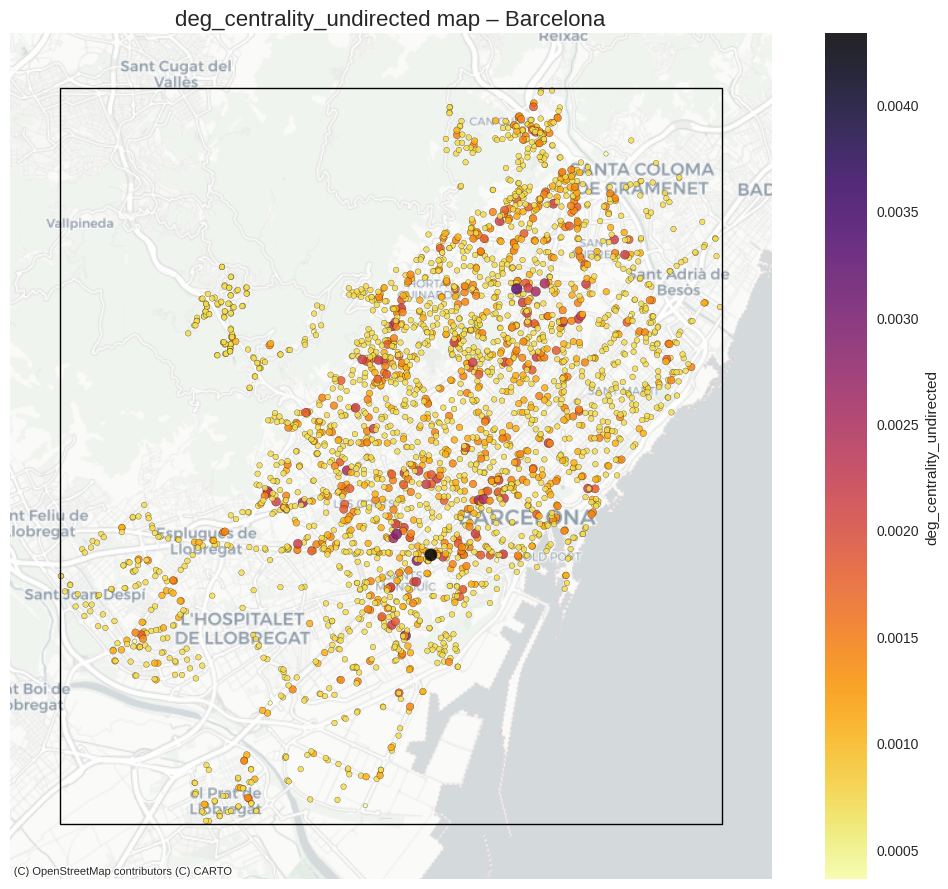

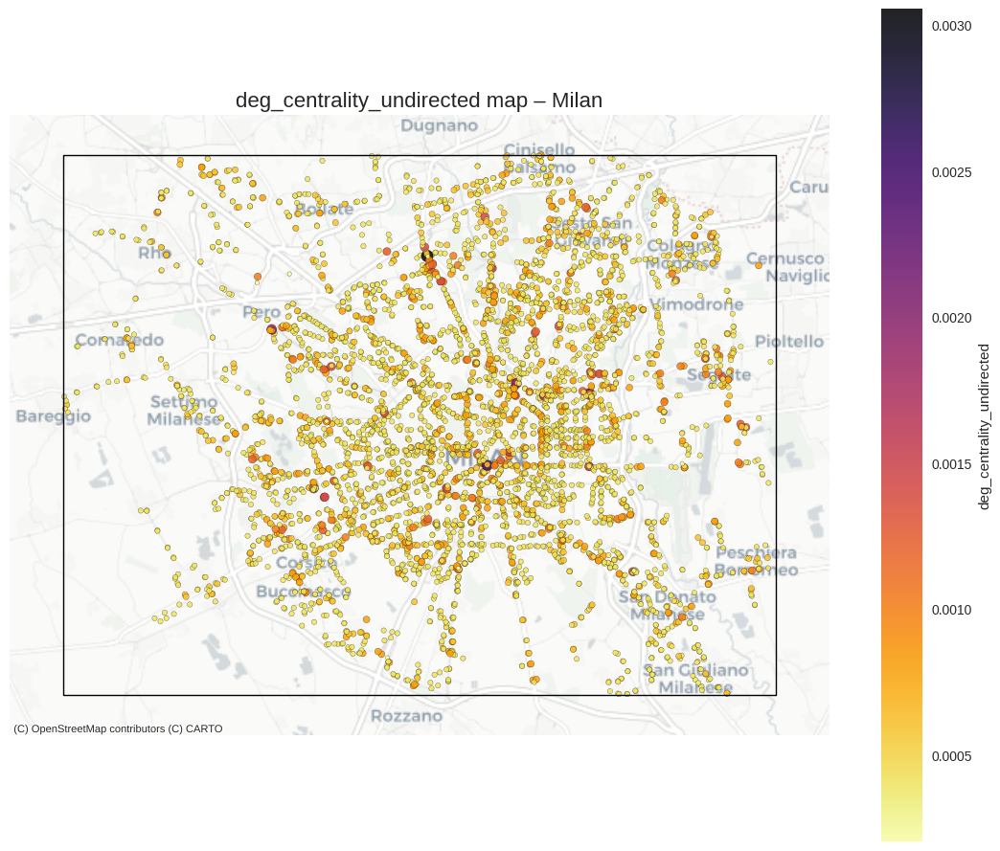

In [ ]:

#Degree centrality maps on basemap


def degree_centrality_map_with_basemap(
    G,
    df_deg,
    centrality_col,
    city_name,
    shapefile_path,
    stops_crs="EPSG:4326",
    shapefile_crs="EPSG:4326",
    min_size=10,
    max_size=80,
    cmap="inferno_r",
    zoom_out_factor=1.15,
):


    # make sure the centrality column exists
    if centrality_col not in df_deg.columns:
        raise ValueError(f"{centrality_col} not found in df_deg columns.")

    # build GeoDataFrame for stops
    df_plot = df_deg.reset_index().dropna(subset=["stop_lat", "stop_lon", centrality_col])
    if df_plot.empty:
        print(f"No valid coordinates or centrality for {city_name}.")
        return

    gdf_stops = gpd.GeoDataFrame(
        df_plot,
        geometry=gpd.points_from_xy(df_plot["stop_lon"], df_plot["stop_lat"]),
        crs=stops_crs,
    )

    # read shapefile
    if not os.path.exists(shapefile_path):
        raise FileNotFoundError(f"Shapefile not found: {shapefile_path}")

    gdf_area = gpd.read_file(shapefile_path)
    if gdf_area.crs is None:
        gdf_area.set_crs(shapefile_crs, inplace=True)
    elif gdf_area.crs.to_string() != shapefile_crs:
        gdf_area = gdf_area.to_crs(shapefile_crs)

    # reproject both to WebMercator
    gdf_stops = gdf_stops.to_crs("EPSG:3857")
    gdf_area = gdf_area.to_crs("EPSG:3857")

    try:
        area_union = gdf_area.union_all()
        gdf_stops = gdf_stops[gdf_stops.within(area_union)]
    except Exception:
        pass

    if gdf_stops.empty:
        print(f"No stops within boundary for {city_name}.")
        return

    cvals = gdf_stops[centrality_col].values
    c_min, c_max = np.min(cvals), np.max(cvals)
    if c_max > c_min:
        norm_c = (cvals - c_min) / (c_max - c_min)
    else:
        norm_c = np.zeros_like(cvals)

    sizes = min_size + norm_c * (max_size - min_size)

    fig, ax = plt.subplots(figsize=(11, 9))

    gdf_area.boundary.plot(ax=ax, color="black", linewidth=1.0)

    sc = ax.scatter(
        gdf_stops.geometry.x,
        gdf_stops.geometry.y,
        c=cvals,
        s=sizes,
        cmap=cmap,
        alpha=0.85,
        edgecolors="black",
        linewidths=0.2,
    )

    xmin, ymin, xmax, ymax = gdf_area.total_bounds
    x_center = (xmin + xmax) / 2
    y_center = (ymin + ymax) / 2
    x_half_range = (xmax - xmin) * zoom_out_factor / 2
    y_half_range = (ymax - ymin) * zoom_out_factor / 2

    ax.set_xlim(x_center - x_half_range, x_center + x_half_range)
    ax.set_ylim(y_center - y_half_range, y_center + y_half_range)

    ctx.add_basemap(ax, crs="EPSG:3857", source=ctx.providers.CartoDB.Positron)

    cbar = plt.colorbar(sc, ax=ax)
    cbar.set_label(centrality_col)

    ax.set_title(f"{centrality_col} map – {city_name}", fontsize=16)
    ax.set_axis_off()
    plt.tight_layout()
    plt.show()



BARCELONA_SHAPEFILE_PATH = "/content/drive/MyDrive/SNA_Project/shapefiles/barcelona_boundary.shp"
MILAN_SHAPEFILE_PATH      = "/content/drive/MyDrive/SNA_Project/shapefiles/milan_boundary.shp"

STOPS_CRS_BARCA     = "EPSG:4326"
STOPS_CRS_MILAN     = "EPSG:4326"
SHAPEFILE_CRS_BARCA = "EPSG:4326"
SHAPEFILE_CRS_MILAN = "EPSG:4326"

# Unweighted degree centrality maps
degree_centrality_map_with_basemap(
    G_barcelona,
    deg_barcelona,
    centrality_col="deg_centrality_undirected",
    city_name="Barcelona",
    shapefile_path=BARCELONA_SHAPEFILE_PATH,
    stops_crs=STOPS_CRS_BARCA,
    shapefile_crs=SHAPEFILE_CRS_BARCA,
)

degree_centrality_map_with_basemap(
    G_milan,
    deg_milan,
    centrality_col="deg_centrality_undirected",
    city_name="Milan",
    shapefile_path=MILAN_SHAPEFILE_PATH,
    stops_crs=STOPS_CRS_MILAN,
    shapefile_crs=SHAPEFILE_CRS_MILAN,
)


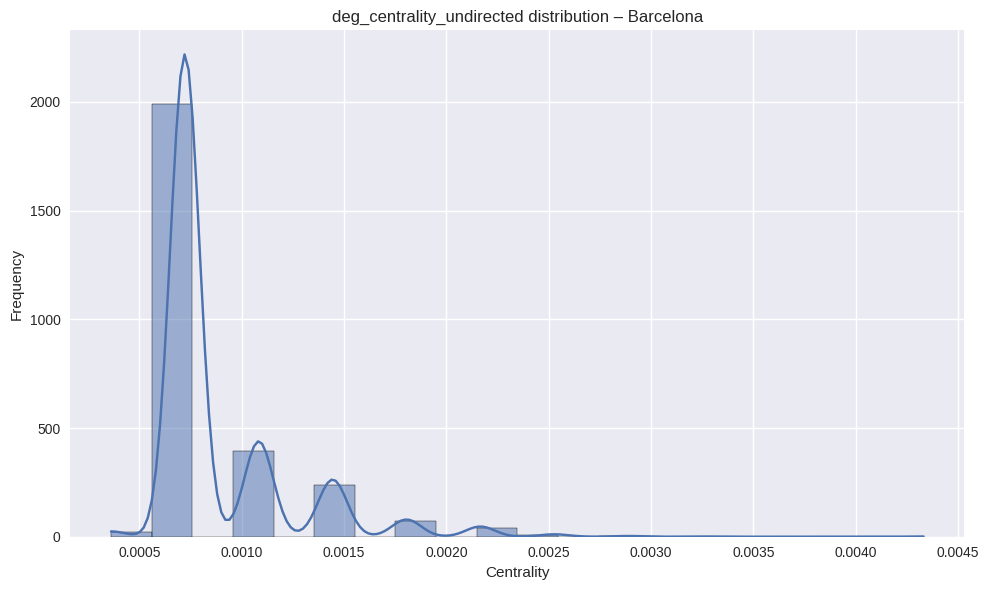

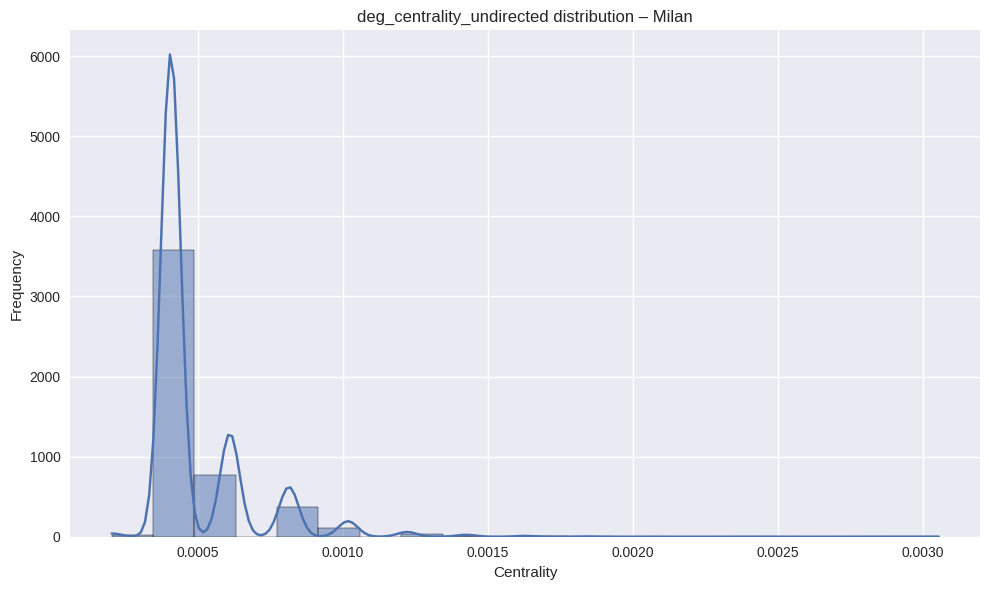

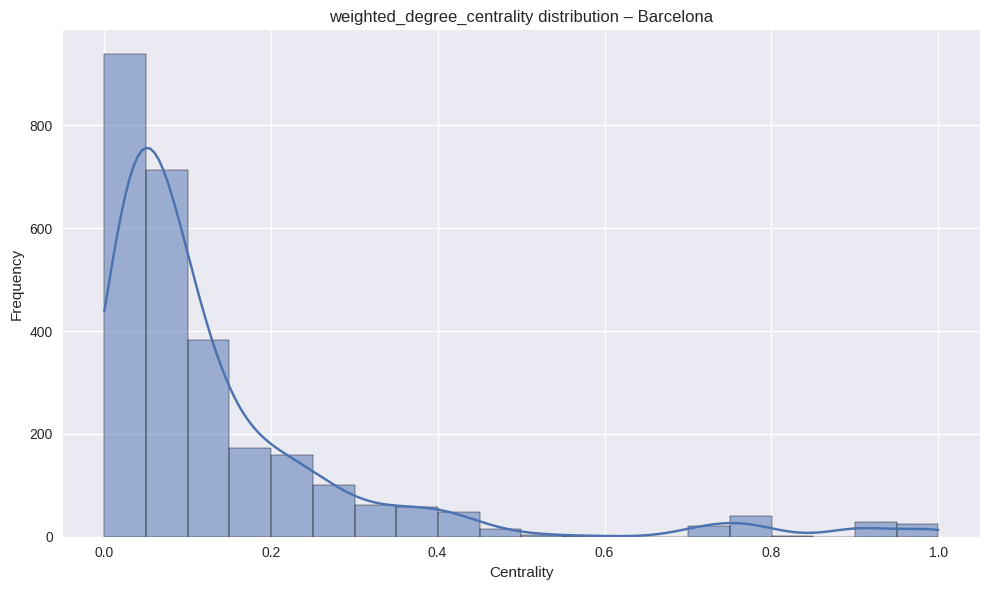

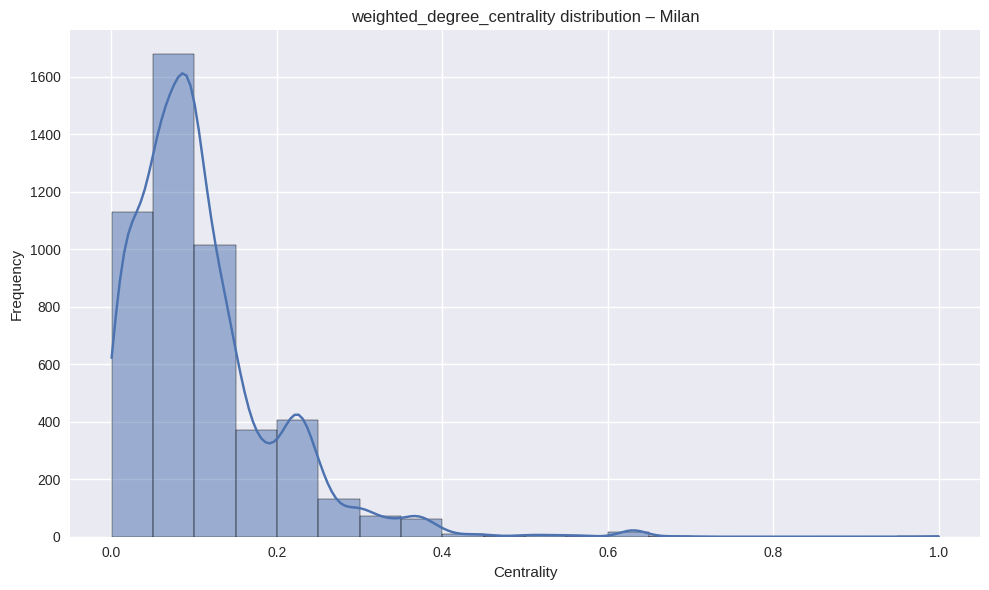

In [ ]:

#Degree centrality histograms


def plot_degree_centrality_histogram(df, measure, city_name, bins=20):
    values = df[measure].dropna()

    plt.figure(figsize=(10, 6))
    sns.histplot(values, bins=bins, kde=True)
    plt.title(f"{measure} distribution – {city_name}")
    plt.xlabel("Centrality")
    plt.ylabel("Frequency")
    plt.tight_layout()
    plt.show()

# unweighted degree centrality
plot_degree_centrality_histogram(deg_barcelona, "deg_centrality_undirected", "Barcelona")
plot_degree_centrality_histogram(deg_milan,     "deg_centrality_undirected", "Milan")

# weighted-degree centrality – keep if you use it in text
plot_degree_centrality_histogram(deg_barcelona, "weighted_degree_centrality", "Barcelona")
plot_degree_centrality_histogram(deg_milan,     "weighted_degree_centrality", "Milan")


/tmp/ipython-input-1724041161.py:47: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


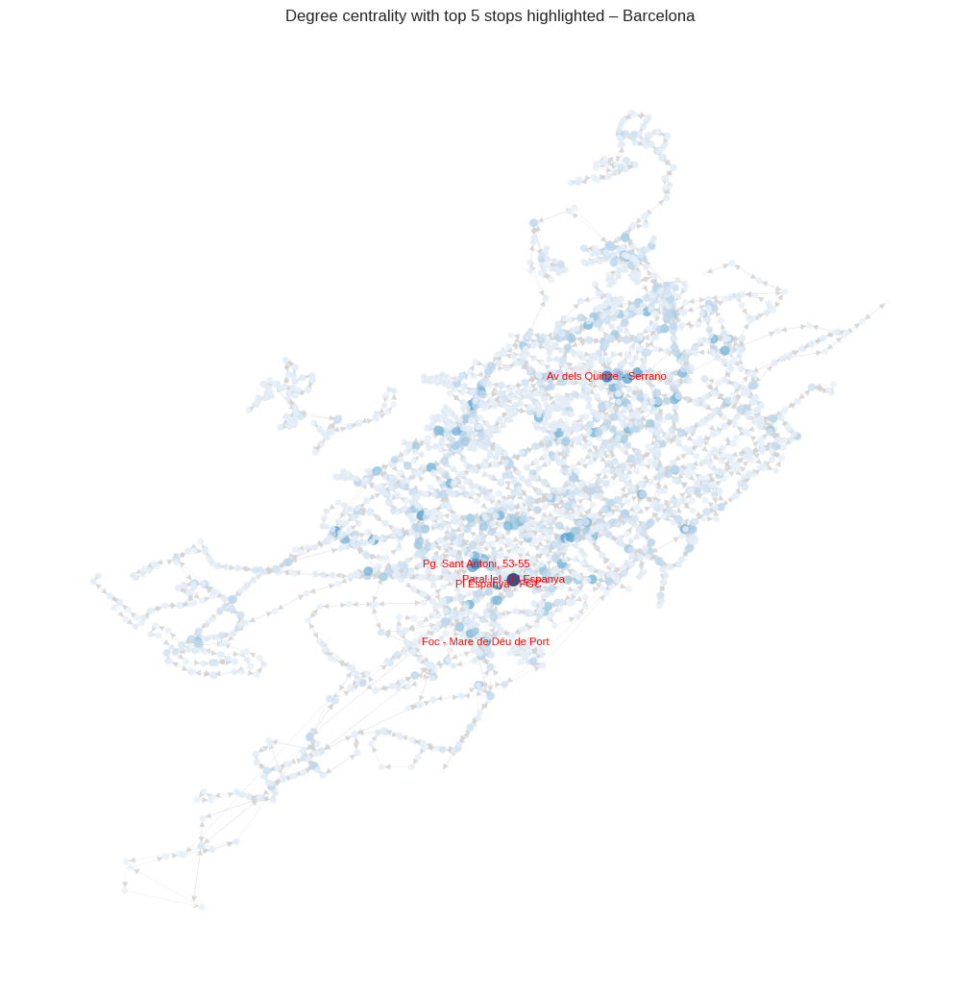

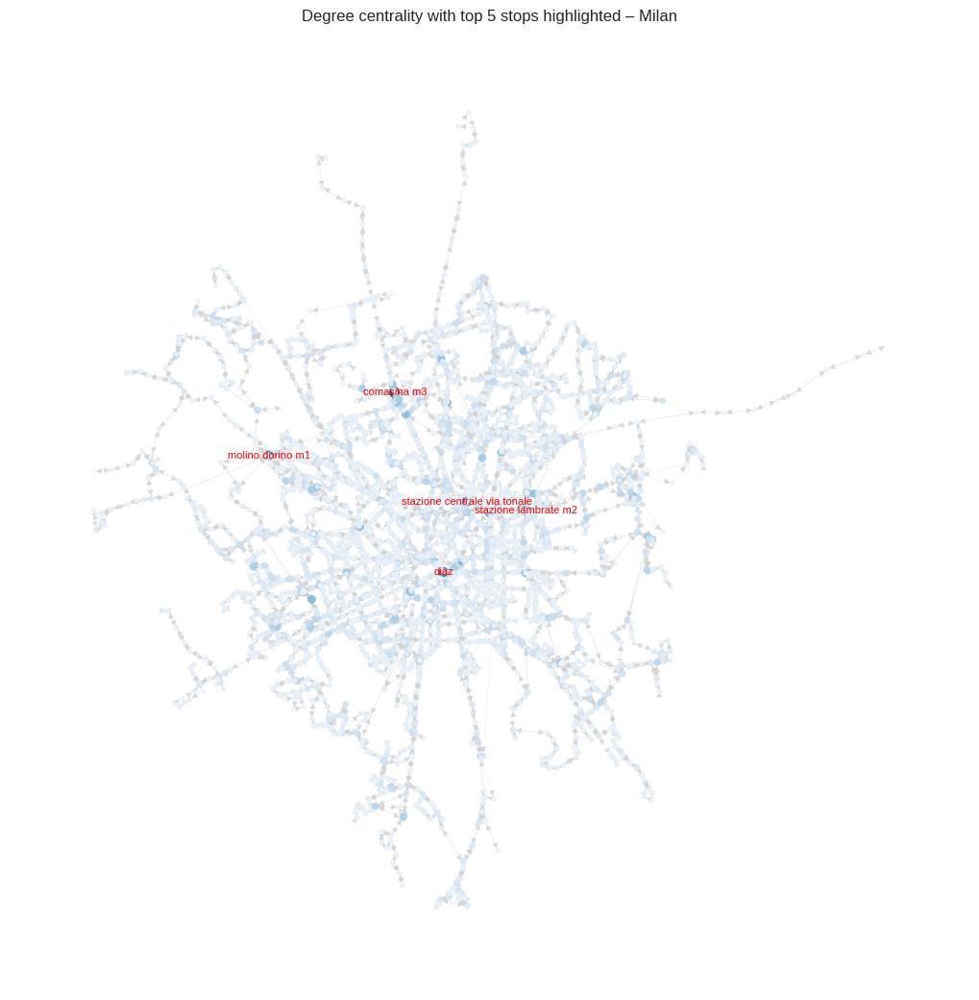

In [ ]:

#  Network with top degree hubs highlighted


def plot_network_top_degree(G, df_deg, city_name, top_n=5, figsize=(10, 10)):
    # pick top nodes by unweighted degree centrality
    top_nodes = (
        df_deg.sort_values("deg_centrality_undirected", ascending=False)
              .head(top_n)
              .index.tolist()
    )

    # positions from GTFS coordinates
    pos = {}
    for n, data in G.nodes(data=True):
        try:
            x = float(data["stop_lon"])
            y = float(data["stop_lat"])
            pos[n] = (x, y)
        except (KeyError, TypeError, ValueError):
            continue

    centrality = df_deg["deg_centrality_undirected"].to_dict()

    plt.figure(figsize=figsize)
    nx.draw(
        G,
        pos,
        node_size=[centrality.get(n, 0.0) * 20000 + 5 for n in G.nodes()],
        node_color=[centrality.get(n, 0.0) for n in G.nodes()],
        cmap=plt.cm.Blues,
        with_labels=False,
        edge_color="lightgrey",
        width=0.2,
        alpha=0.8,
    )

    # label only top nodes
    labels = {
        n: df_deg.loc[n, "stop_name"] if (n in df_deg.index and pd.notna(df_deg.loc[n, "stop_name"])) else str(n)
        for n in top_nodes if n in pos
    }
    nx.draw_networkx_labels(G, pos, labels=labels, font_size=8, font_color="red")

    plt.title(f"Degree centrality with top {top_n} stops highlighted – {city_name}")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

plot_network_top_degree(G_barcelona, deg_barcelona, "Barcelona", top_n=5)
plot_network_top_degree(G_milan,     deg_milan,     "Milan",     top_n=5)


# Betweenness Centrality

In [ ]:

# BETWEENNESS CENTRALITY – BARCELONA & MILAN


def compute_betweenness(G, city_name="", weight="weight", normalized=True):
    """
    Compute (weighted) betweenness centrality for a directed graph G.
    Returns a DataFrame indexed by stop_id with column 'betweenness_centrality'.
    """
    print(f"\nComputing betweenness centrality for {city_name}...")
    print(f"  Nodes = {G.number_of_nodes()}, edges = {G.number_of_edges()}")

    bet = nx.betweenness_centrality(G, weight=weight, normalized=normalized)

    bet_df = (
        pd.DataFrame.from_dict(bet, orient="index", columns=["betweenness_centrality"])
        .sort_values("betweenness_centrality", ascending=False)
    )
    return bet_df


# Compute & merge for both cities
bet_barcelona = compute_betweenness(G_barcelona, city_name="Barcelona")
bet_milan     = compute_betweenness(G_milan,     city_name="Milan")

# Directly assign the betweenness_centrality column to avoid join conflicts
deg_barcelona['betweenness_centrality'] = bet_barcelona['betweenness_centrality']
deg_milan['betweenness_centrality'] = bet_milan['betweenness_centrality']


Computing betweenness centrality for Barcelona...
  Nodes = 2771, edges = 3584

Computing betweenness centrality for Milan...
  Nodes = 4913, edges = 6118


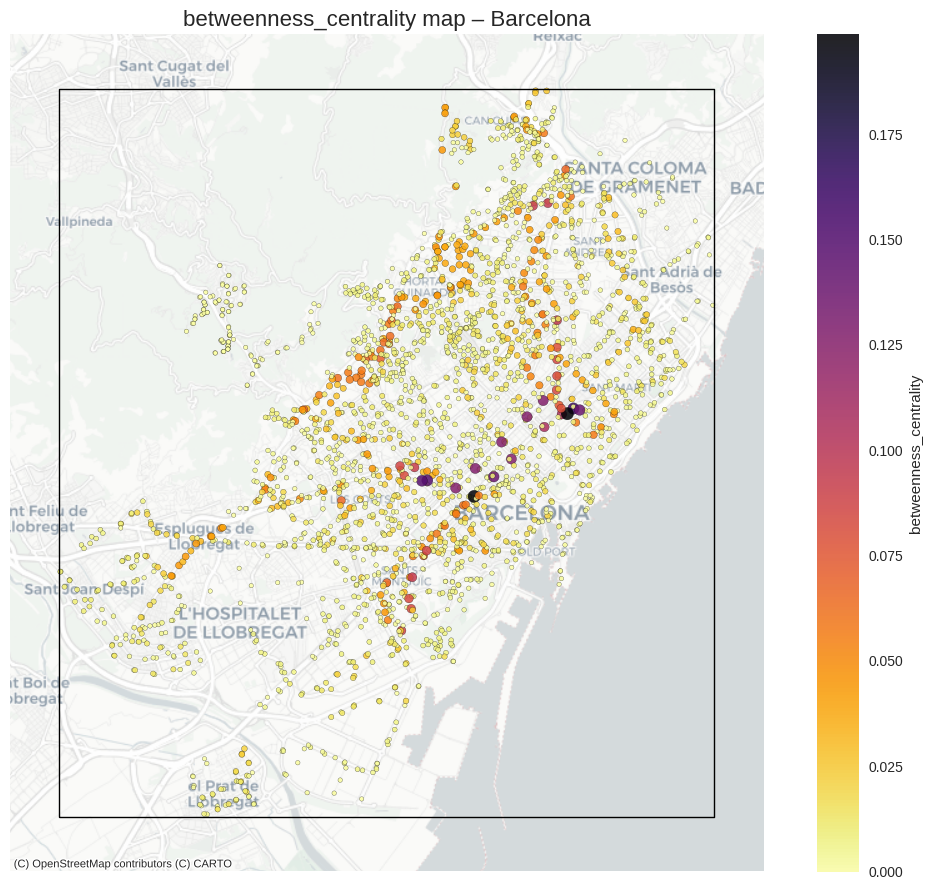

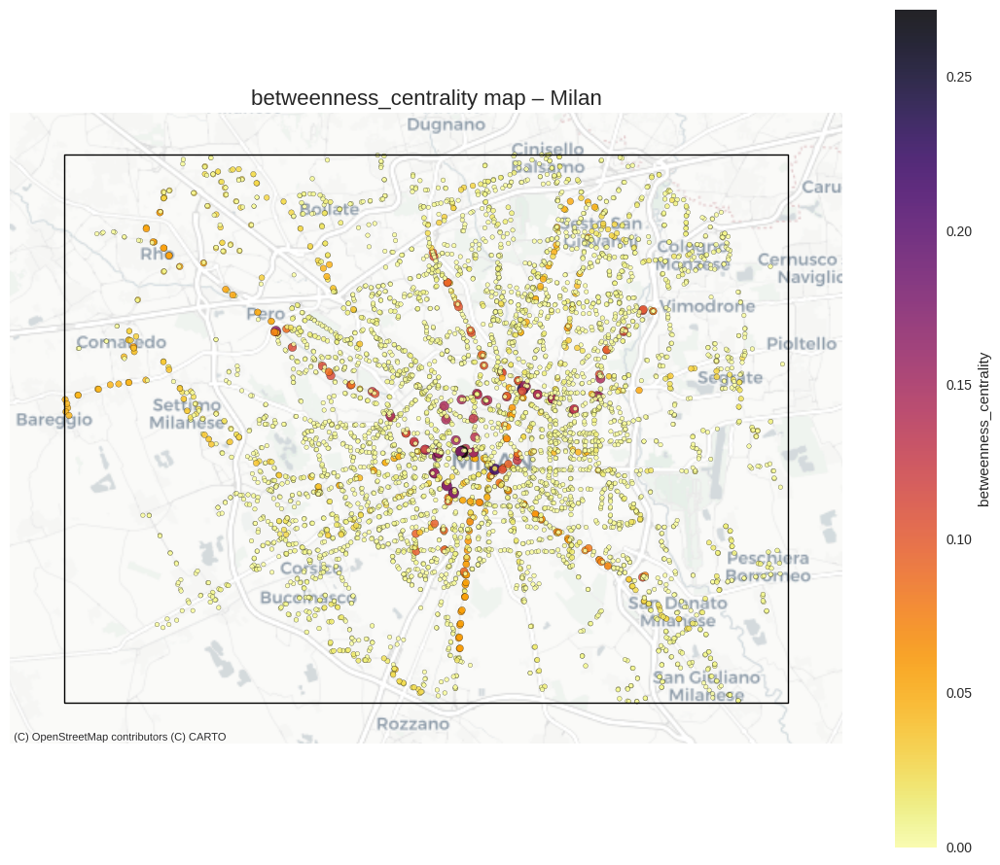

In [ ]:
# Betweenness centrality maps on basemap

degree_centrality_map_with_basemap(
    G_barcelona,
    deg_barcelona,
    centrality_col="betweenness_centrality",
    city_name="Barcelona",
    shapefile_path=BARCELONA_SHAPEFILE_PATH,
    stops_crs=STOPS_CRS_BARCA,
    shapefile_crs=SHAPEFILE_CRS_BARCA,
    zoom_out_factor=1.15,
)

degree_centrality_map_with_basemap(
    G_milan,
    deg_milan,
    centrality_col="betweenness_centrality",
    city_name="Milan",
    shapefile_path=MILAN_SHAPEFILE_PATH,
    stops_crs=STOPS_CRS_MILAN,
    shapefile_crs=SHAPEFILE_CRS_MILAN,
    zoom_out_factor=1.15,
)


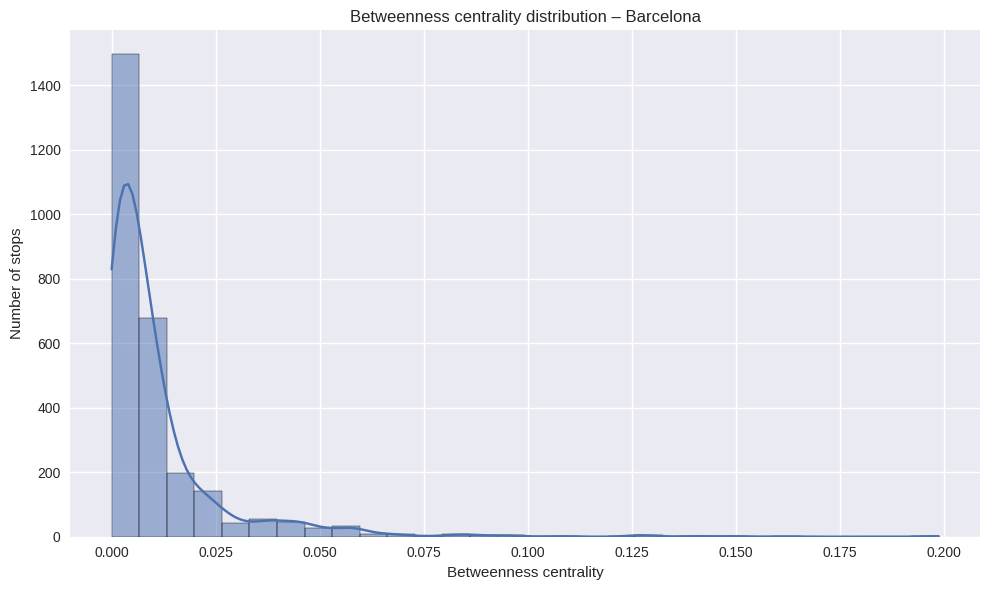

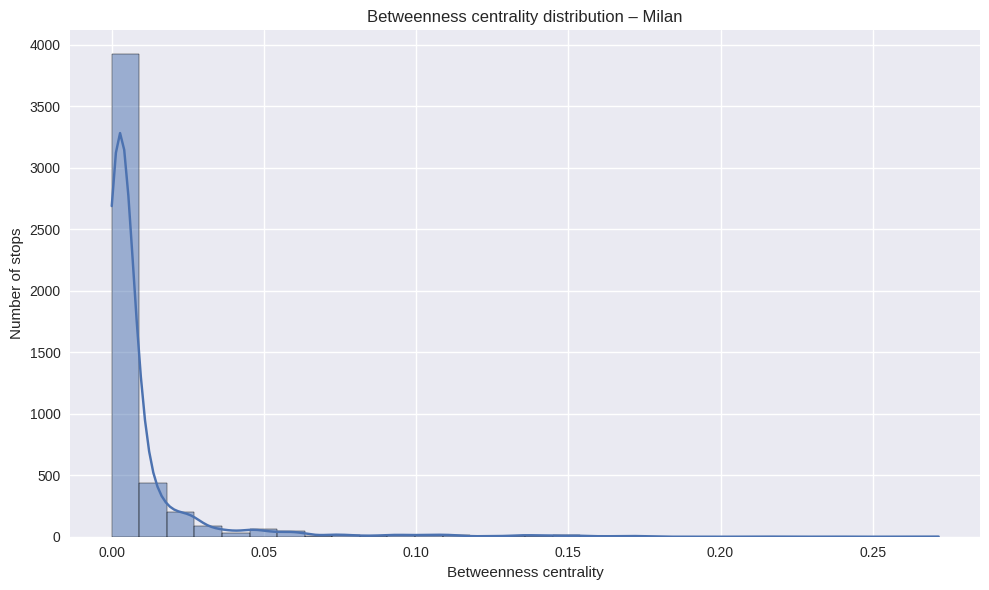

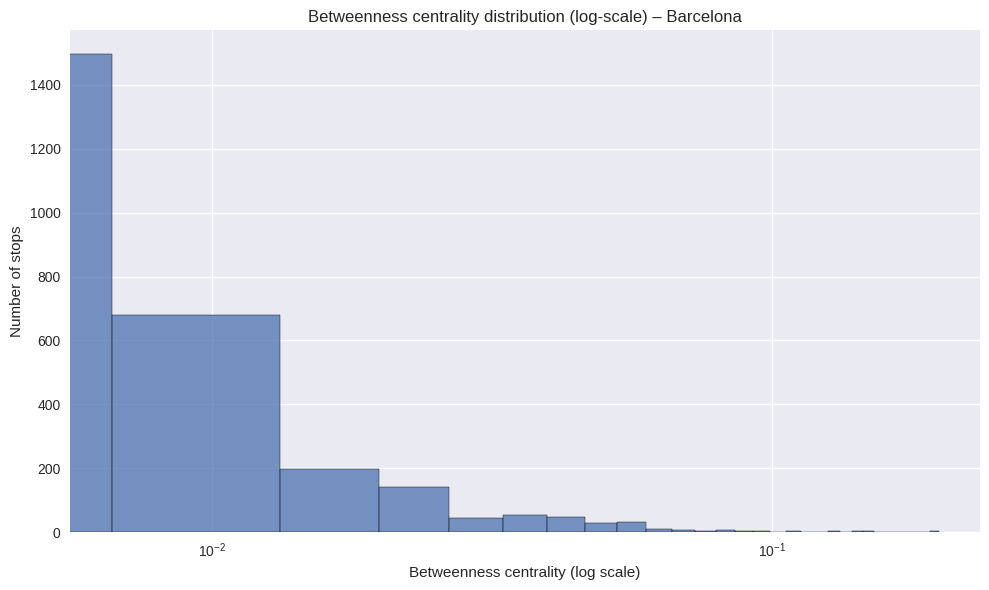

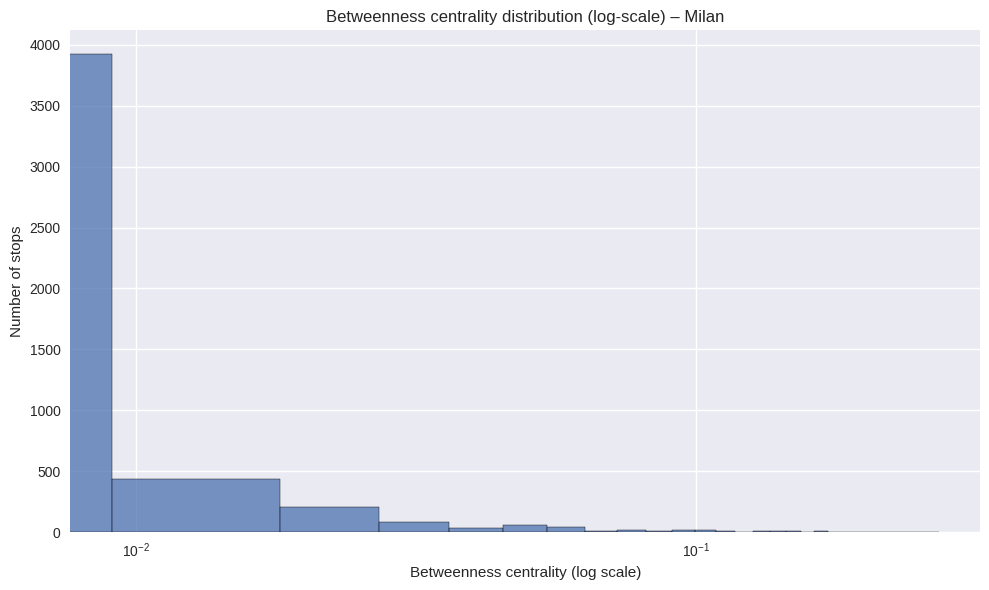

In [ ]:
# Betweenness centrality histograms

def plot_betweenness_hist(df, city_name, bins=30):
    vals = df["betweenness_centrality"].dropna()
    plt.figure(figsize=(10, 6))
    sns.histplot(vals, bins=bins, kde=True)
    plt.title(f"Betweenness centrality distribution – {city_name}")
    plt.xlabel("Betweenness centrality")
    plt.ylabel("Number of stops")
    plt.tight_layout()
    plt.show()

def plot_betweenness_hist_log(df, city_name, bins=30):
    vals = df["betweenness_centrality"].dropna()
    plt.figure(figsize=(10, 6))
    sns.histplot(vals, bins=bins)
    plt.xscale("log")
    plt.title(f"Betweenness centrality distribution (log-scale) – {city_name}")
    plt.xlabel("Betweenness centrality (log scale)")
    plt.ylabel("Number of stops")
    plt.tight_layout()
    plt.show()

plot_betweenness_hist(deg_barcelona, "Barcelona")
plot_betweenness_hist(deg_milan,     "Milan")

plot_betweenness_hist_log(deg_barcelona, "Barcelona")
plot_betweenness_hist_log(deg_milan,     "Milan")


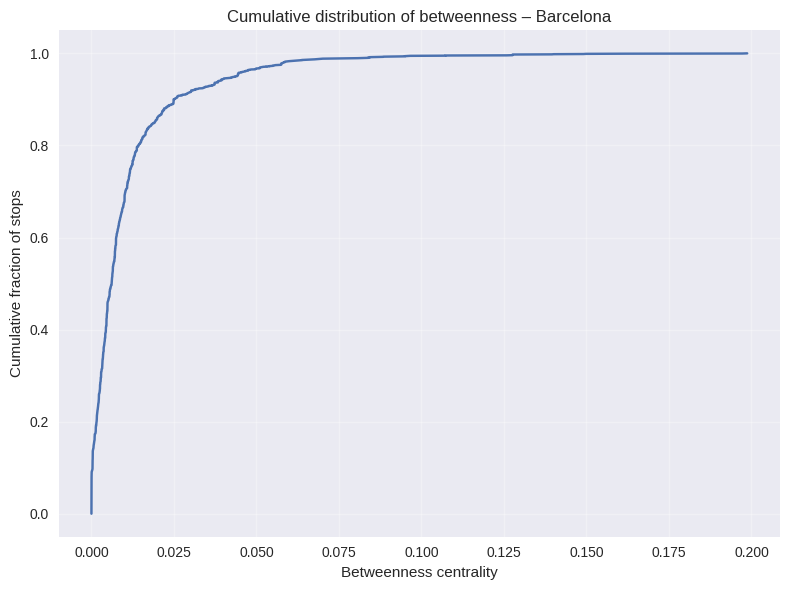

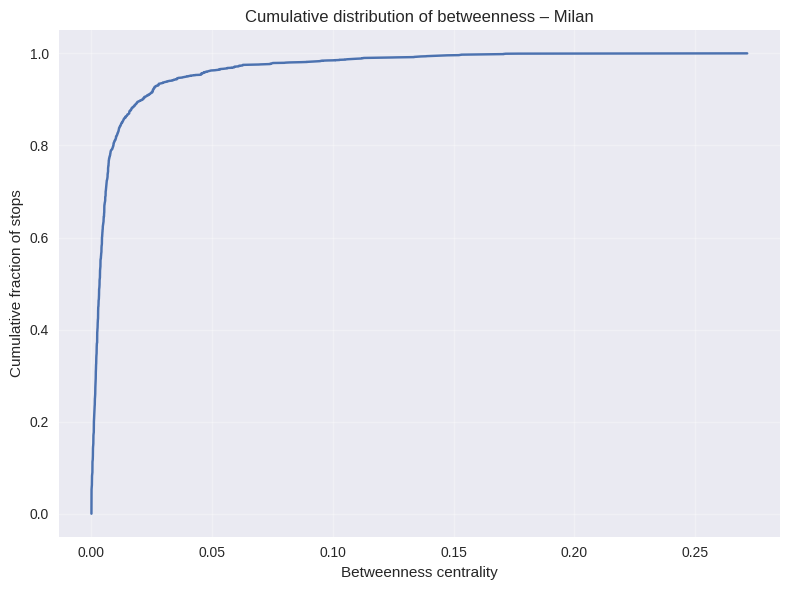

In [ ]:
# --- Cumulative distribution of betweenness centrality ---

def plot_betweenness_cdf(df, city_name):
    vals = df["betweenness_centrality"].dropna().values
    vals_sorted = np.sort(vals)
    cdf = np.arange(1, len(vals_sorted) + 1) / len(vals_sorted)

    plt.figure(figsize=(8, 6))
    plt.plot(vals_sorted, cdf)
    plt.xlabel("Betweenness centrality")
    plt.ylabel("Cumulative fraction of stops")
    plt.title(f"Cumulative distribution of betweenness – {city_name}")
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

plot_betweenness_cdf(deg_barcelona, "Barcelona")
plot_betweenness_cdf(deg_milan,     "Milan")


In [ ]:
# Top-k stops by betweenness centrality (tables with names)

def top_betweenness_table(G, df_deg, city_name, k=10):
    df = df_deg[["betweenness_centrality"]].dropna().copy()

    names = {}
    for n, data in G.nodes(data=True):
        if n in df.index:
            names[n] = data.get("stop_name", "")
    df["stop_name"] = pd.Series(names)

    df = df.sort_values("betweenness_centrality", ascending=False).head(k)

    print(f"\nTop {k} stops by betweenness centrality in {city_name}:")
    display(df[["stop_name", "betweenness_centrality"]])

top_betweenness_table(G_barcelona, deg_barcelona, "Barcelona", k=10)
top_betweenness_table(G_milan,     deg_milan,     "Milan",     k=10)



Top 10 stops by betweenness centrality in Barcelona:


,stop_name,betweenness_centrality
stop_id,,
2.3371.690086,Badajoz - Diagonal,0.198701
2.1075.688054,Pl Universitat,0.197155
2.1879.679497,Diagonal - Ciutat de Granada,0.161840
2.1264.674612,Villarroel - Hospital Clínic,0.149873
2.1466.692781,Còrsega - Hospital Clínic,0.149084
2.3850.698505,Roc Boronat - Tànger,0.140052
2.1070.674374,Gran Via - Pau Claris,0.139543
2.3801.697436,Aragó - Muntaner,0.127613
2.236.685297,Aragó - Enamorats,0.127613



Top 10 stops by betweenness centrality in Milan:


,stop_name,betweenness_centrality
stop_id,,
16895,cadorna m1 m2,0.271649
11884,stazione centrale m2 m3,0.236003
20056,diaz,0.218645
11187,p.le cantore,0.176759
17233,cadorna m1 m2,0.171580
10899,p.le baracca,0.171255
11212,v.le coni zugna via solari,0.171255
11193,c.so colombo p.le cantore,0.170674
17037,p.le aquileia,0.170664


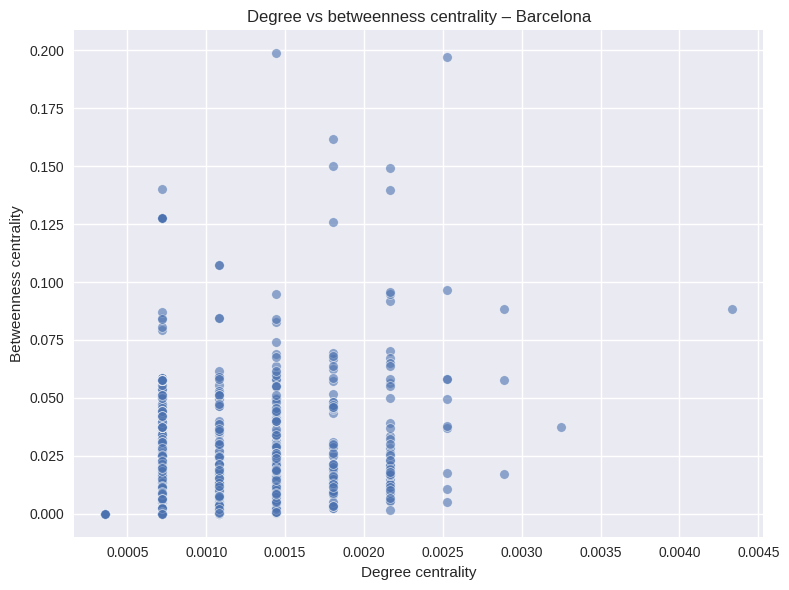

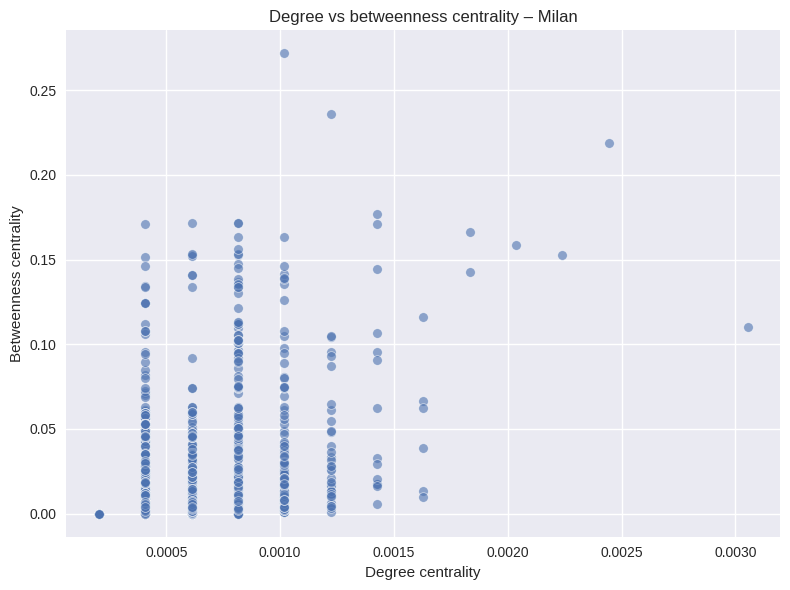

In [ ]:
#Relationship between degree and betweenness centrality

def plot_degree_vs_betweenness(df_deg, city_name):
    plt.figure(figsize=(8, 6))
    sns.scatterplot(
        x=df_deg["deg_centrality_undirected"],
        y=df_deg["betweenness_centrality"],
        alpha=0.6,
    )
    plt.xlabel("Degree centrality")
    plt.ylabel("Betweenness centrality")
    plt.title(f"Degree vs betweenness centrality – {city_name}")
    plt.tight_layout()
    plt.show()

plot_degree_vs_betweenness(deg_barcelona, "Barcelona")
plot_degree_vs_betweenness(deg_milan,     "Milan")


/tmp/ipython-input-979896730.py:40: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


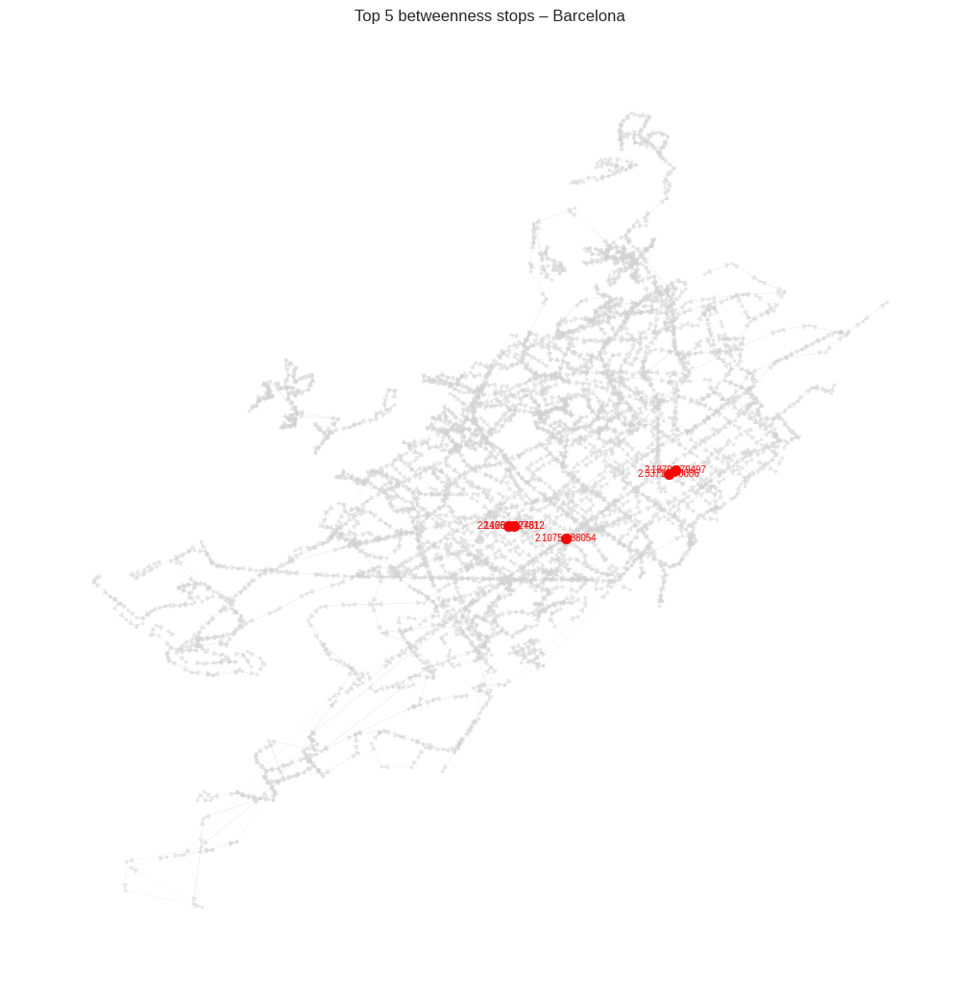

/tmp/ipython-input-979896730.py:40: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


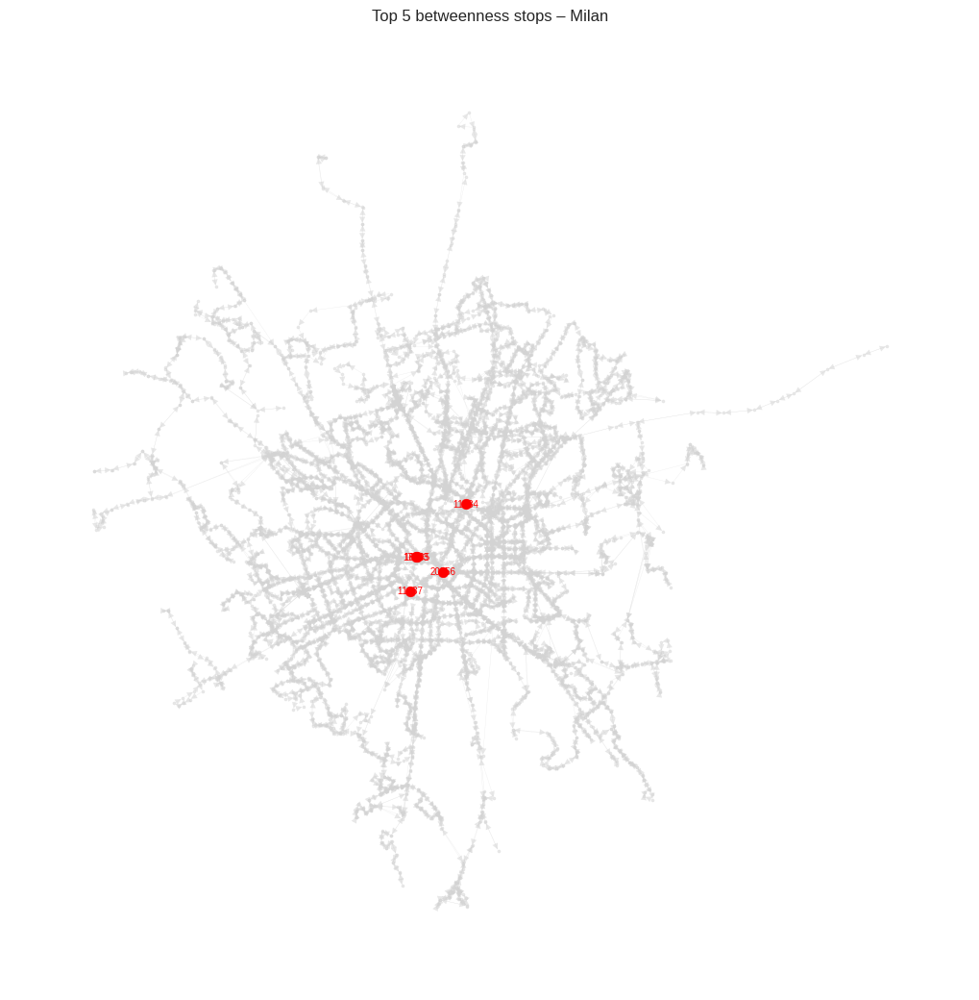

In [ ]:
# Network with top betweenness stops highlighted

def plot_network_top_betweenness(G, df_deg, city_name, top_n=5, figsize=(10, 10)):
    df = df_deg[["betweenness_centrality"]].dropna()
    top_nodes = df.sort_values("betweenness_centrality", ascending=False).head(top_n).index.tolist()

    pos = {}
    for n, data in G.nodes(data=True):
        try:
            pos[n] = (float(data["stop_lon"]), float(data["stop_lat"]))
        except (KeyError, TypeError, ValueError):
            continue

    plt.figure(figsize=figsize)

    nx.draw(
        G,
        pos,
        node_size=5,
        node_color="lightgrey",
        edge_color="lightgrey",
        width=0.2,
        alpha=0.5,
        with_labels=False,
    )

    nx.draw_networkx_nodes(
        G,
        pos,
        nodelist=top_nodes,
        node_color="red",
        node_size=60,
    )

    labels = {n: n for n in top_nodes if n in pos}
    nx.draw_networkx_labels(G, pos, labels=labels, font_size=7, font_color="red")

    plt.title(f"Top {top_n} betweenness stops – {city_name}")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

plot_network_top_betweenness(G_barcelona, deg_barcelona, "Barcelona", top_n=5)
plot_network_top_betweenness(G_milan,     deg_milan,     "Milan",     top_n=5)


In [ ]:
#Summary statistics for betweenness

def betweenness_summary(df, city_name):
    vals = df["betweenness_centrality"].dropna()
    return pd.Series(
        {
            "num_stops": len(vals),
            "min": vals.min(),
            "max": vals.max(),
            "mean": vals.mean(),
            "median": vals.median(),
            "std": vals.std(),
        },
        name=city_name,
    )

summary_betweenness = pd.concat(
    [
        betweenness_summary(deg_barcelona, "Barcelona"),
        betweenness_summary(deg_milan,     "Milan"),
    ],
    axis=1,
).T

summary_betweenness


,num_stops,min,max,mean,median,std
Barcelona,2771.0,0.0,0.198701,0.010879,0.006141,0.016621
Milan,4913.0,0.0,0.271649,0.009240,0.003345,0.020418


# Closeness Centrality

In [ ]:

# CLOSENESS CENTRALITY – BARCELONA & MILAN


# 1) Add a "distance" attribute = 1 / weight

def add_distance_attribute(G, weight_key="weight", distance_key="distance"):
    """
    For each edge, create a 'distance' attribute = 1 / weight.
    Higher frequency (larger weight) → shorter effective distance.
    """
    for u, v, data in G.edges(data=True):
        w = data.get(weight_key, 1.0)
        if w <= 0:
            w = 1.0
        data[distance_key] = 1.0 / float(w)

# Apply to both city graphs
add_distance_attribute(G_barcelona)
add_distance_attribute(G_milan)


# 2) Compute closeness and merge into degree tables

def compute_closeness(G, df_deg, city_name="", distance_key="distance"):
    """
    Compute closeness centrality using a given edge 'distance' attribute.
    Returns an updated df_deg with a 'closeness_centrality' column
    and prints summary statistics + quick top/bottom check.
    """
    print(f"\n=== Closeness centrality – {city_name} ===")
    print(f"Nodes: {G.number_of_nodes()}, edges: {G.number_of_edges()}")

    clo = nx.closeness_centrality(G, distance=distance_key)

    clo_df = pd.DataFrame.from_dict(
        clo, orient="index", columns=["closeness_centrality"]
    )

    # Drop old column if it exists (re-runs)
    df_deg = df_deg.drop(columns=["closeness_centrality"], errors="ignore")
    df_deg = df_deg.join(clo_df, how="left")

    vals = df_deg["closeness_centrality"].dropna().values
    print(f"Mean:   {vals.mean():.4f}")
    print(f"Median: {np.median(vals):.4f}")
    print(f"Std:    {vals.std():.4f}")

    # top5 = df_deg.sort_values("closeness_centrality", ascending=False).head(5)
    # bottom5 = df_deg.sort_values("closeness_centrality", ascending=True).head(5)

    # print("\nTop 5 stops by closeness:")
    # display(top5[["stop_name", "closeness_centrality"]])

    # print("\nBottom 5 stops by closeness:")
    # display(bottom5[["stop_name", "closeness_centrality"]])

    return df_deg

deg_barcelona = compute_closeness(G_barcelona, deg_barcelona, city_name="Barcelona")
deg_milan     = compute_closeness(G_milan,     deg_milan,     city_name="Milan")



=== Closeness centrality – Barcelona ===
Nodes: 2771, edges: 3584
Mean:   5.0182
Median: 5.6972
Std:    1.9881

=== Closeness centrality – Milan ===
Nodes: 4913, edges: 6118
Mean:   7.0064
Median: 7.6242
Std:    2.2186


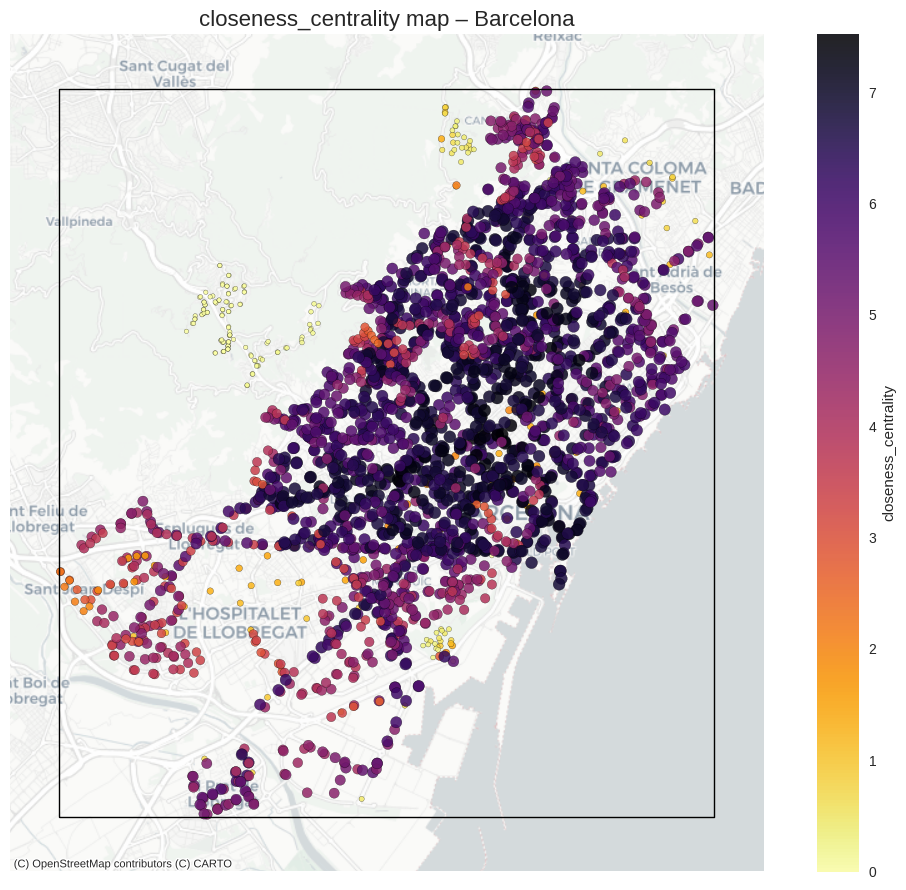

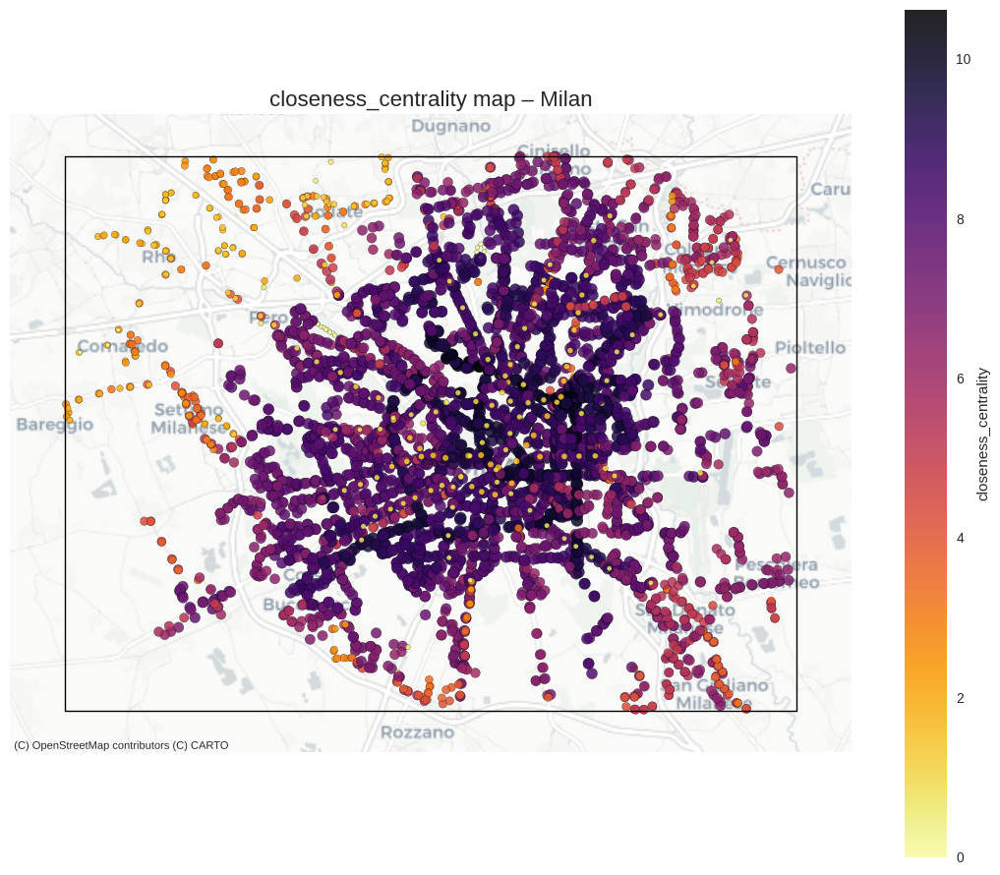

In [ ]:
# 3) Closeness centrality maps on basemap

degree_centrality_map_with_basemap(
    G_barcelona,
    deg_barcelona,
    centrality_col="closeness_centrality",
    city_name="Barcelona",
    shapefile_path=BARCELONA_SHAPEFILE_PATH,
    stops_crs=STOPS_CRS_BARCA,
    shapefile_crs=SHAPEFILE_CRS_BARCA,
    zoom_out_factor=1.15,
)

degree_centrality_map_with_basemap(
    G_milan,
    deg_milan,
    centrality_col="closeness_centrality",
    city_name="Milan",
    shapefile_path=MILAN_SHAPEFILE_PATH,
    stops_crs=STOPS_CRS_MILAN,
    shapefile_crs=SHAPEFILE_CRS_MILAN,
    zoom_out_factor=1.15,
)


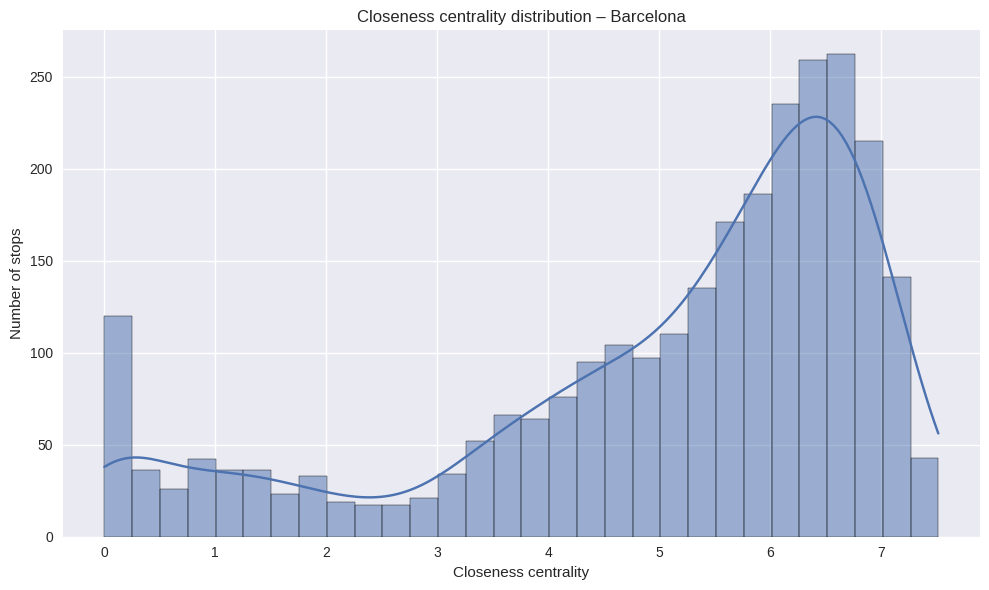

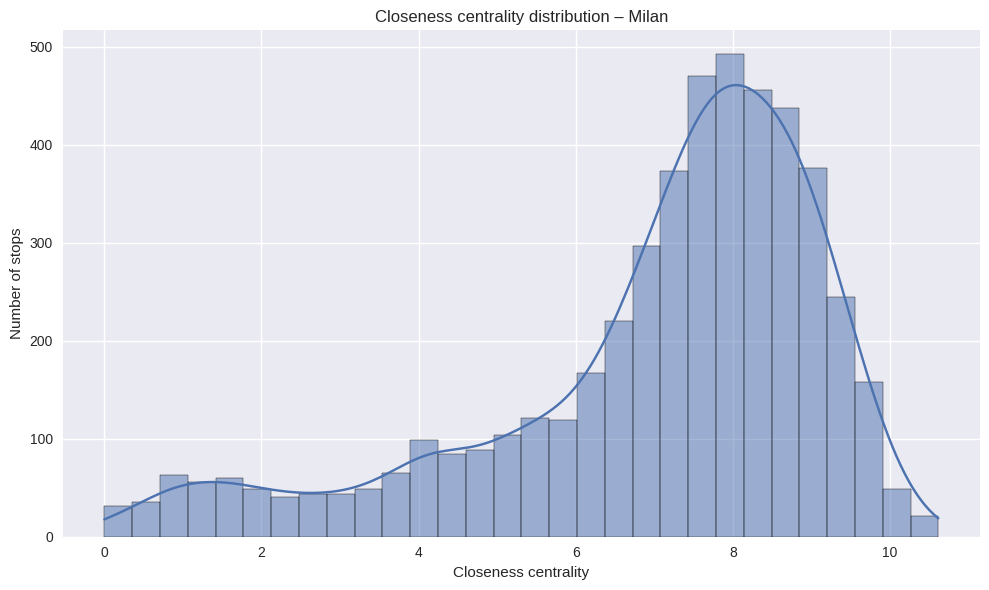

In [ ]:
# 4) Closeness centrality histogram

def plot_closeness_hist(df, city_name, bins=30):
    vals = df["closeness_centrality"].dropna()
    plt.figure(figsize=(10, 6))
    sns.histplot(vals, bins=bins, kde=True)
    plt.title(f"Closeness centrality distribution – {city_name}")
    plt.xlabel("Closeness centrality")
    plt.ylabel("Number of stops")
    plt.tight_layout()
    plt.show()

plot_closeness_hist(deg_barcelona, "Barcelona")
plot_closeness_hist(deg_milan,     "Milan")


In [ ]:
# 5) Top / bottom stops by closeness

def closeness_tables(G, df_deg, city_name, k=10):
    df = df_deg[["closeness_centrality"]].dropna().copy()

    # Attach stop_name if missing
    if "stop_name" not in df.columns:
        names = {n: data.get("stop_name", "") for n, data in G.nodes(data=True)}
        df["stop_name"] = pd.Series(names)

    df_sorted = df.sort_values("closeness_centrality", ascending=False)

    print(f"\nTop {k} stops by closeness – {city_name}:")
    display(df_sorted.head(k)[["stop_name", "closeness_centrality"]])

    print(f"\nBottom {k} stops by closeness – {city_name}:")
    display(df_sorted.tail(k)[["stop_name", "closeness_centrality"]])

closeness_tables(G_barcelona, deg_barcelona, "Barcelona", k=10)
closeness_tables(G_milan,     deg_milan,     "Milan",     k=10)



Top 10 stops by closeness – Barcelona:


,stop_name,closeness_centrality
stop_id,,
2.1228.696966,València - Pg Sant Joan,7.518306
2.1554.674690,Josep Tarradellas - Viladomat,7.505533
2.1492.690405,Pg de Sant Joan - Pl Mossèn Jacint Verdaguer,7.478745
2.1318.674380,València - Diagonal,7.470264
2.65.691710,Josep Tarradellas - Francesc Macià,7.468026
2.146.674792,Rosselló - Bruc,7.460278
2.1080.690454,Diagonal - Pau Claris,7.457984
2.213.699757,Pg de Sant Joan - Còrsega,7.437596
2.1490.675121,Pau Claris - Mallorca,7.424092



Bottom 10 stops by closeness – Barcelona:


,stop_name,closeness_centrality
stop_id,,
2.2123.676104,Savina - Poncelles,0.025011
2.2095.676081,"Camí Baix del Mas Sauró, direcció Vallvidrera",0.024890
2.2124.676105,Bohemis - Amarant,0.024655
2.2096.676082,"Torrent del Rovelló, direcció Vallvidrera",0.024619
2.2125.676106,Major del Rectoret,0.024309
2.2126.676107,Parc Municipal de Vallvidrera,0.023973
2.2127.682482,Camí del Sanatori - FGC Baixador de Vallvidrera,0.023646
1.9901,Paral·lel,0.000722
1.9902,Parc de Montjuïc,0.000722



Top 10 stops by closeness – Milan:


,stop_name,closeness_centrality
stop_id,,
11610,via bernina,10.615122
11346,v.le jenner,10.513125
12228,via pecchio v.le abruzzi,10.494522
12211,loreto m1 m2,10.481191
11327,lancetti,10.468525
11342,p.le nigra,10.413070
12469,p.za aspromonte,10.399196
11918,sondrio m3,10.390794
12200,loreto m1 m2,10.387420



Bottom 10 stops by closeness – Milan:


,stop_name,closeness_centrality
stop_id,,
15279,interno cimitero bruzzano,0.040717
15281,interno cimitero bruzzano,0.040717
16379,Via S.Carlo Via D'Acquisto (Cornaredo),0.002748
16380,Via C.na Croca Via Repubblica (Cornaredo),0.002443
16382,CORNAREDO (C.na Croce),0.001832
10699,v.le espinasse via palizzi,0.001221
10469,p.le cacciatori delle alpi,0.000000
16821,bisceglie m1,0.000000
14108,via po via filzi (cormano),0.000000


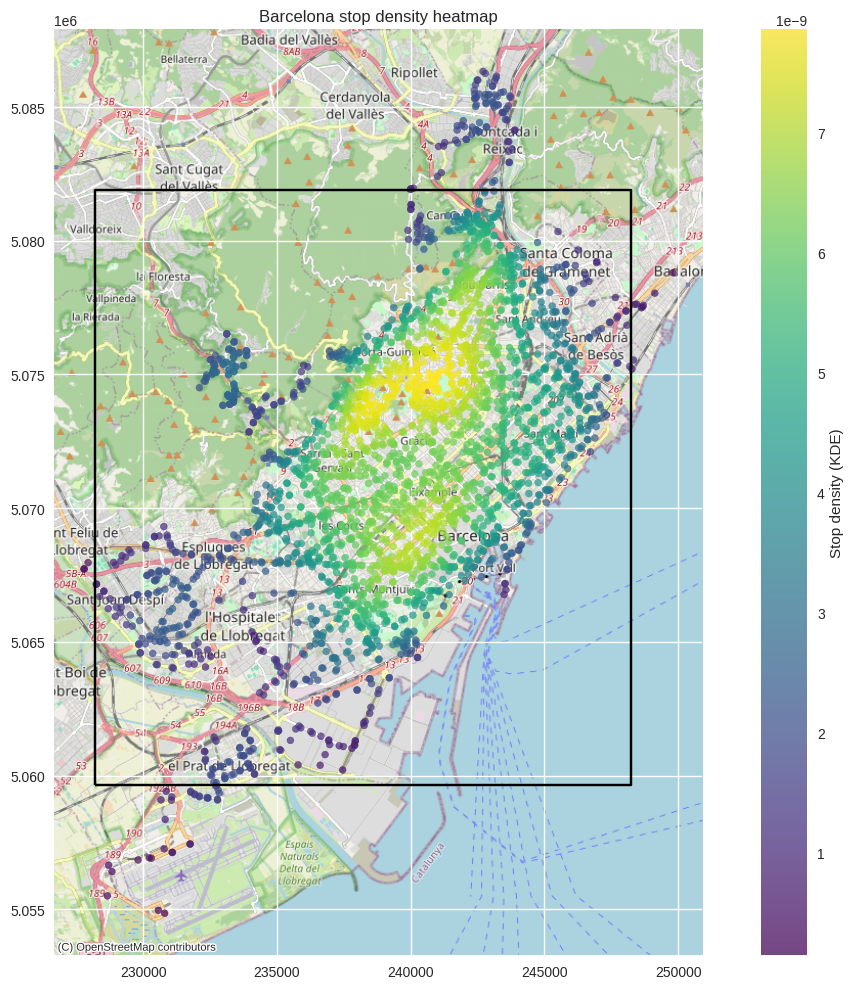

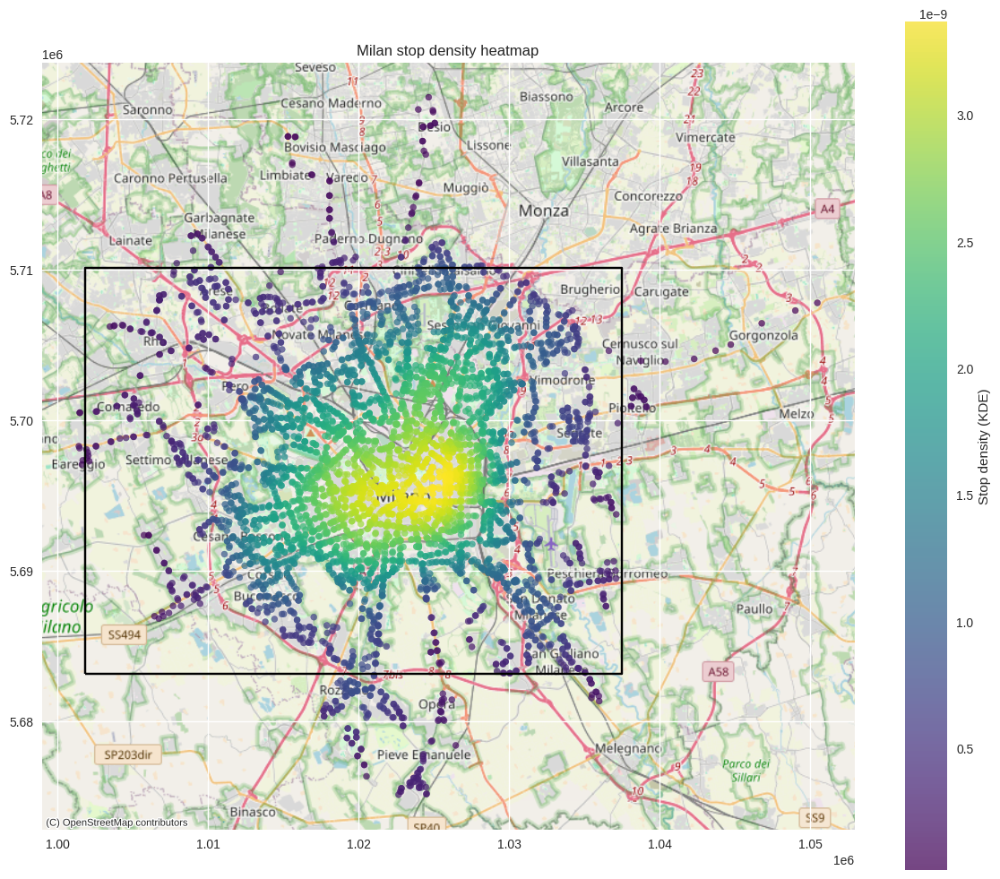

In [ ]:
# 6) Stop density heatmaps (KDE) – spatial distribution of stops

def stop_density_heatmap(G, city_name, shapefile_path, stops_crs="EPSG:4326"):
    xs = []
    ys = []
    for _, data in G.nodes(data=True):
        try:
            xs.append(float(data["stop_lon"]))
            ys.append(float(data["stop_lat"]))
        except (KeyError, TypeError, ValueError):
            continue

    if len(xs) == 0:
        print(f"No coordinates found for {city_name}.")
        return

    stops_df = pd.DataFrame({"lon": xs, "lat": ys})
    stops_gdf = gpd.GeoDataFrame(
        stops_df,
        geometry=gpd.points_from_xy(stops_df.lon, stops_df.lat),
        crs=stops_crs,
    ).to_crs("EPSG:3857")

    x = stops_gdf.geometry.x.values
    y = stops_gdf.geometry.y.values

    xy = np.vstack([x, y])
    kde = gaussian_kde(xy)
    z = kde(xy)

    area_gdf = gpd.read_file(shapefile_path).to_crs("EPSG:3857")

    plt.figure(figsize=(12, 10))
    scatter = plt.scatter(x, y, c=z, cmap="viridis", s=25, alpha=0.7, edgecolor=None)
    area_gdf.boundary.plot(ax=plt.gca(), color="black")
    ctx.add_basemap(plt.gca(), crs="EPSG:3857", source=ctx.providers.OpenStreetMap.Mapnik)
    plt.colorbar(scatter, label="Stop density (KDE)")
    plt.title(f"{city_name} stop density heatmap")
    plt.tight_layout()
    plt.show()

stop_density_heatmap(G_barcelona, "Barcelona", BARCELONA_SHAPEFILE_PATH, stops_crs=STOPS_CRS_BARCA)
stop_density_heatmap(G_milan,     "Milan",     MILAN_SHAPEFILE_PATH,     stops_crs=STOPS_CRS_MILAN)


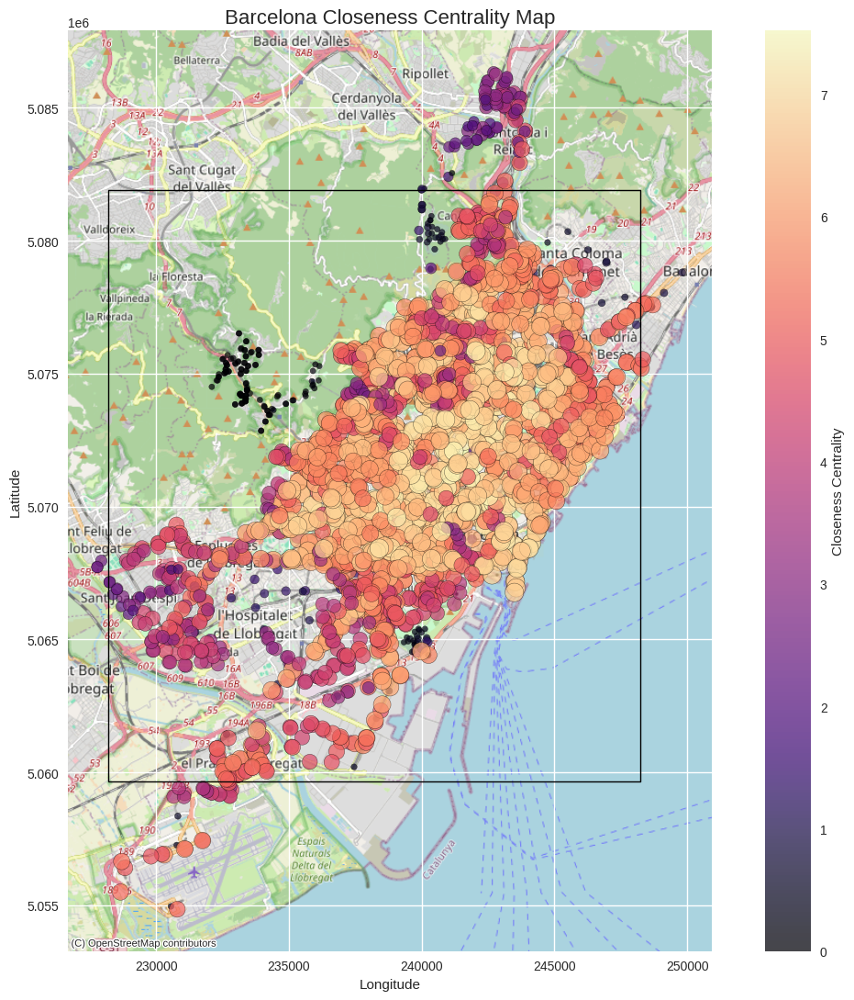

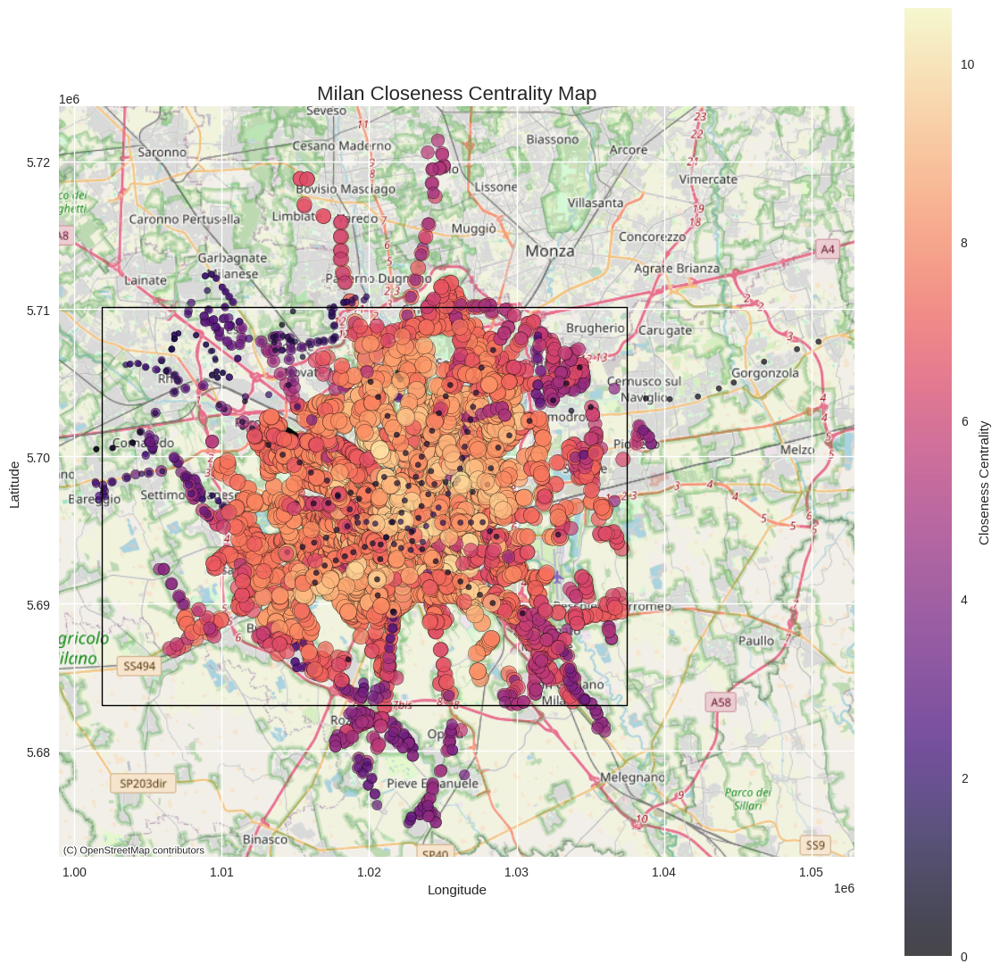

In [ ]:

# Closeness centrality basemap plot

def plot_closeness_centrality_map(
    G,
    df_deg,
    city_name,
    shapefile_path,
    stops_crs="EPSG:4326",
    shapefile_crs="EPSG:4326",
    cmap="magma",
):
    """
    Plot closeness centrality on top of a basemap + city boundary.

    G          : NetworkX graph with node attributes 'stop_lat', 'stop_lon'
    df_deg     : DataFrame indexed by stop_id with column 'closeness_centrality'
    city_name  : title text
    shapefile_path : path to city boundary shapefile
    stops_crs  : CRS of stop_lat/stop_lon in the graph (usually EPSG:4326)
    shapefile_crs : CRS of the shapefile (usually EPSG:4326)
    """

    # 1) Collect coordinates + centrality
    rows = []
    for n, data in G.nodes(data=True):
        if n not in df_deg.index:
            continue
        try:
            lat = float(data["stop_lat"])
            lon = float(data["stop_lon"])
            c   = float(df_deg.loc[n, "closeness_centrality"])
            rows.append((n, lon, lat, c))
        except (KeyError, TypeError, ValueError):
            continue

    if not rows:
        print(f"No valid stops for {city_name}.")
        return

    df = pd.DataFrame(rows, columns=["stop_id", "lon", "lat", "closeness"])

    # 2) Convert stops to GeoDataFrame in WebMercator
    stops_gdf = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df.lon, df.lat),
        crs=stops_crs,
    ).to_crs("EPSG:3857")

    # 3) Load and project city boundary
    area_gdf = gpd.read_file(shapefile_path)
    if area_gdf.crs is None:
        area_gdf.set_crs(shapefile_crs, inplace=True)
    else:
        area_gdf = area_gdf.to_crs(shapefile_crs)
    area_gdf = area_gdf.to_crs("EPSG:3857")

    # 4) Size scaling: use quantiles so a few big values don't explode the plot
    clo_vals = stops_gdf["closeness"].values
    q05, q95 = np.quantile(clo_vals, [0.05, 0.95])
    denom = max(q95 - q05, 1e-9)
    norm = (clo_vals - q05) / denom
    norm = np.clip(norm, 0, 1)

    # final point sizes (tune if you want smaller/larger)
    sizes = 20 + 200 * norm

    # 5) Plot
    fig, ax = plt.subplots(figsize=(12, 11))

    # city border
    area_gdf.boundary.plot(ax=ax, color="black", linewidth=1.0)

    # scatter of stops
    sc = ax.scatter(
        stops_gdf.geometry.x,
        stops_gdf.geometry.y,
        c=stops_gdf["closeness"],
        s=sizes,
        cmap=cmap,
        alpha=0.7,
        edgecolor="k",
        linewidth=0.3,
    )

    # basemap
    ctx.add_basemap(ax, crs="EPSG:3857", source=ctx.providers.OpenStreetMap.Mapnik)

    # labels + colorbar
    ax.set_title(f"{city_name} Closeness Centrality Map", fontsize=16)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")

    cbar = plt.colorbar(sc, ax=ax)
    cbar.set_label("Closeness Centrality")

    plt.tight_layout()
    plt.show()


plot_closeness_centrality_map(
    G_barcelona,
    deg_barcelona,
    city_name="Barcelona",
    shapefile_path=BARCELONA_SHAPEFILE_PATH,
    stops_crs=STOPS_CRS_BARCA,
    shapefile_crs=SHAPEFILE_CRS_BARCA,
)

plot_closeness_centrality_map(
    G_milan,
    deg_milan,
    city_name="Milan",
    shapefile_path=MILAN_SHAPEFILE_PATH,
    stops_crs=STOPS_CRS_MILAN,
    shapefile_crs=SHAPEFILE_CRS_MILAN,
)


# Eigenvector Centrality


Computing Eigenvector Centrality for Barcelona...
  - Converged using Directed Graph.
  - Top 5 Stops by Eigenvector Centrality in Barcelona:


,eigen_centrality,stop_name
1.905,0.394137,Parc Nou
1.903,0.357199,Aeroport T2
1.909,0.356602,Les Moreres
1.912,0.338328,Fira
1.904,0.313358,Mas Blau



Computing Eigenvector Centrality for Milan...
  - Converged using Directed Graph.
  - Top 5 Stops by Eigenvector Centrality in Milan:


,eigen_centrality,stop_name
CENTRALE FS,0.386154,CENTRALE FS
GARIBALDI FS,0.386140,GARIBALDI FS
ZARA,0.386009,ZARA
GIOIA,0.303577,GIOIA
SONDRIO,0.303524,SONDRIO


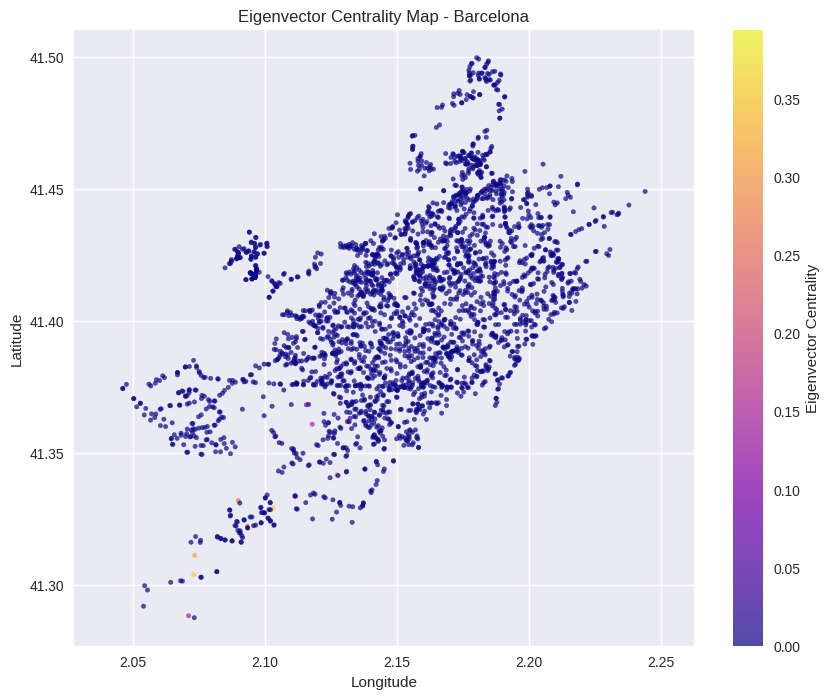

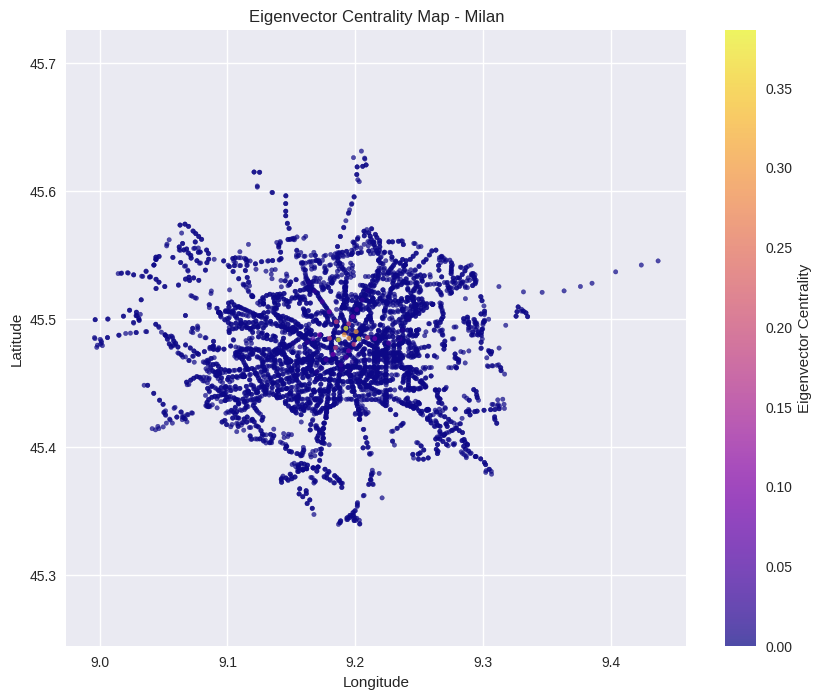

In [ ]:

# EIGENVECTOR CENTRALITY
def compute_eigenvector_centrality(G, city_name=""):
    """
    Computes Eigenvector Centrality.
    Tries directed first; falls back to undirected if convergence fails.
    """
    print(f"\nComputing Eigenvector Centrality for {city_name}...")

    try:

        eigen_centrality = nx.eigenvector_centrality(G, max_iter=10000, tol=1e-06)
        print("  - Converged using Directed Graph.")
    except:

        print("  - Directed convergence failed. Switching to Undirected Graph.")
        eigen_centrality = nx.eigenvector_centrality(G.to_undirected(), max_iter=10000, tol=1e-06)


    nx.set_node_attributes(G, eigen_centrality, name="eigenvector_centrality")


    df_eigen = pd.DataFrame.from_dict(eigen_centrality, orient='index', columns=['eigen_centrality'])


    stop_names = nx.get_node_attributes(G, 'stop_name')
    df_eigen['stop_name'] = df_eigen.index.map(stop_names)

    # Sort by centrality
    df_eigen = df_eigen.sort_values(by='eigen_centrality', ascending=False)

    print(f"  - Top 5 Stops by Eigenvector Centrality in {city_name}:")
    display(df_eigen.head(5))

    return df_eigen


# Run for both cities

eigen_barcelona = compute_eigenvector_centrality(G_barcelona, "Barcelona")
eigen_milan = compute_eigenvector_centrality(G_milan, "Milan")


# Visualization: Scatter Plot

def plot_eigen_map(G, df_eigen, city_name):
    # Extract coordinates
    lats, lons, values = [], [], []
    for node in G.nodes():
        if node in df_eigen.index:
            data = G.nodes[node]
            if 'stop_lat' in data and 'stop_lon' in data:
                lats.append(float(data['stop_lat']))
                lons.append(float(data['stop_lon']))
                values.append(df_eigen.loc[node, 'eigen_centrality'])

    plt.figure(figsize=(10, 8))
    sc = plt.scatter(lons, lats, c=values, cmap='plasma', s=10, alpha=0.7)
    plt.colorbar(sc, label='Eigenvector Centrality')
    plt.title(f"Eigenvector Centrality Map - {city_name}")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.axis('equal')
    plt.grid(True)
    plt.show()

plot_eigen_map(G_barcelona, eigen_barcelona, "Barcelona")
plot_eigen_map(G_milan, eigen_milan, "Milan")

# EDGE BETWEENNESS CENTRALITY


--- Computing APPROXIMATE Edge Betweenness for Barcelona (Sample: 400/2771 nodes) ---
  - Top 5 Critical Links in Barcelona:


,u,v,From,To,Centrality,Frequency
1544,2.1297.689817,2.3341.689734,Mallorca - Marina,Mallorca - Nàpols,0.017957,1281
533,2.234.674424,2.1072.674425,Mallorca - Dos de Maig,Mallorca - Padilla,0.017936,1035
1333,2.1072.674425,2.1297.689817,Mallorca - Padilla,Mallorca - Marina,0.017891,1035
467,2.168.691340,2.929.691353,Diagonal - Francesc Macià,Diagonal - Muntaner,0.016706,1381
612,2.307.689827,2.212.689764,Av Gaudí,Indústria - Independència,0.016349,946



--- Computing APPROXIMATE Edge Betweenness for Milan (Sample: 400/4913 nodes) ---
  - Top 5 Critical Links in Milan:


,u,v,From,To,Centrality,Frequency
2152,12227,12211,v.le gran sasso via garofalo,loreto m1 m2,0.009894,1538
2374,12475,12227,v.le gran sasso p.le piola m2,v.le gran sasso via garofalo,0.009713,1538
959,10972,10989,via bartolini v.le m.te ceneri,p.za firenze,0.009630,1253
2378,12478,12430,v.le romagna p.le piola m2,v.le romagna via pascoli,0.009042,1639
698,10696,10972,via da panicale,via bartolini v.le m.te ceneri,0.008774,956



Plotting Edge Betweenness for Barcelona...
  - Found coordinates for 2771 out of 2771 nodes.


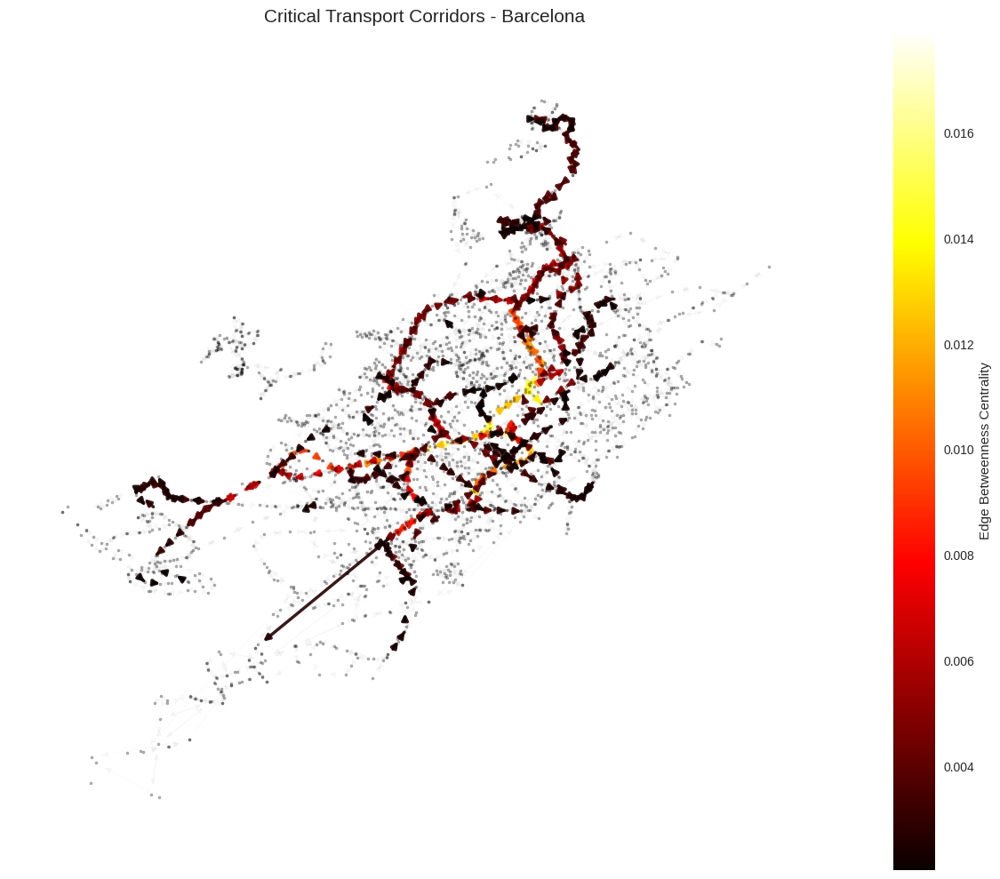


Plotting Edge Betweenness for Milan...
  - Found coordinates for 4913 out of 4913 nodes.


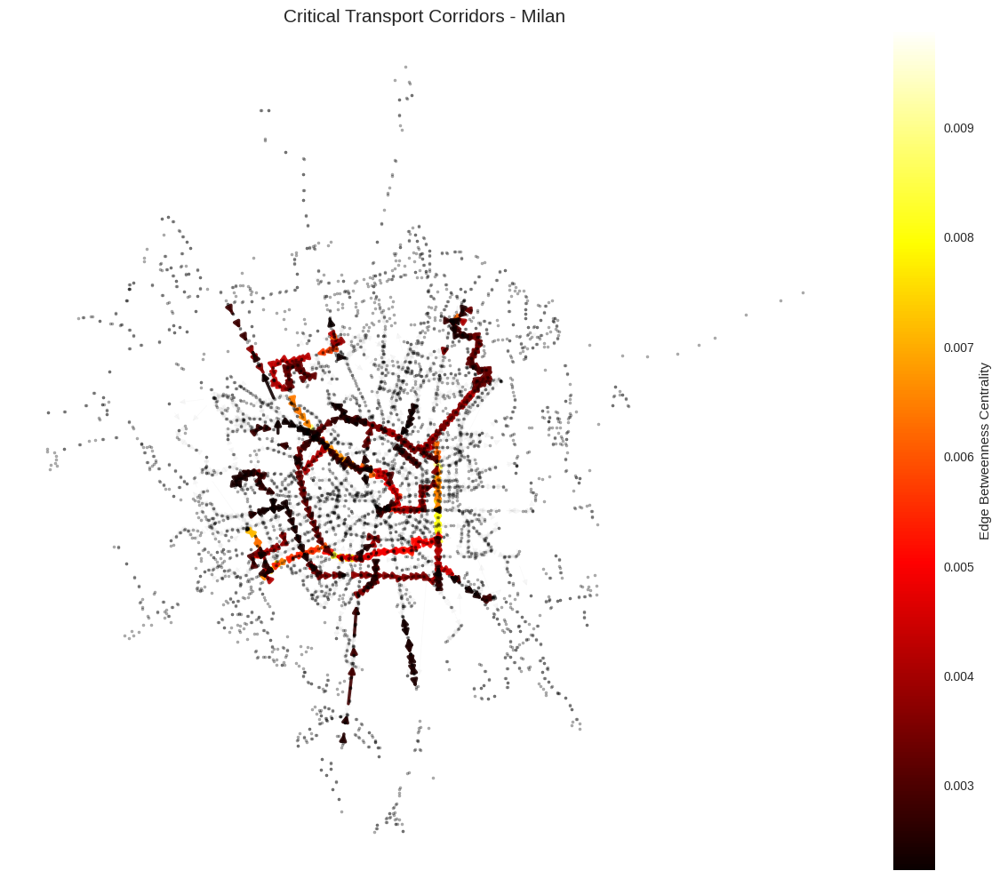

In [ ]:

# EDGE BETWEENNESS CENTRALITY (SAFER VERSION)


def compute_edge_betweenness(G, city_name="", max_k=400):

    num_nodes = G.number_of_nodes()


    if num_nodes <= max_k:
        k = None
        print(f"\n--- Computing EXACT Edge Betweenness for {city_name} ({num_nodes} nodes) ---")
    else:
        k = max_k
        print(f"\n--- Computing APPROXIMATE Edge Betweenness for {city_name} (Sample: {k}/{num_nodes} nodes) ---")


    for u, v, data in G.edges(data=True):
        w = data.get('weight', 1)
        data['distance'] = 1.0 / w if w > 0 else 10.0


    ebc = nx.edge_betweenness_centrality(G, weight='distance', normalized=True, k=k)


    nx.set_edge_attributes(G, ebc, name="edge_betweenness")


    edge_data = []
    for (u, v), centrality in ebc.items():
        u_name = G.nodes[u].get('stop_name', str(u))
        v_name = G.nodes[v].get('stop_name', str(v))

        edge_data.append({
            'u': u, 'v': v,
            'From': u_name,
            'To': v_name,
            'Centrality': centrality,
            'Frequency': G[u][v].get('weight', 0)
        })

    df_ebc = pd.DataFrame(edge_data)
    df_ebc = df_ebc.sort_values(by='Centrality', ascending=False)

    print(f"  - Top 5 Critical Links in {city_name}:")
    display(df_ebc.head(5))

    return df_ebc


# Run for both cities

ebc_barcelona = compute_edge_betweenness(G_barcelona, "Barcelona", max_k=400)
ebc_milan = compute_edge_betweenness(G_milan, "Milan", max_k=400)

def plot_edge_betweenness_safe(G, df_ebc, city_name, top_n_edges=500):
    """
    Plots critical edges safely.
    Uses .get() to avoid KeyErrors and skips bad nodes entirely.
    """
    print(f"\nPlotting Edge Betweenness for {city_name}...")


    pos = {}
    nodes_with_coords = set()

    for n, data in G.nodes(data=True):
        try:

            lat = data.get('stop_lat')
            lon = data.get('stop_lon')


            if lat is not None and lon is not None:
                x = float(lon)
                y = float(lat)

                if not (np.isnan(x) or np.isnan(y)):
                    pos[n] = (x, y)
                    nodes_with_coords.add(n)
        except Exception:

            continue

    print(f"  - Found coordinates for {len(pos)} out of {G.number_of_nodes()} nodes.")

    if len(pos) == 0:
        print("  - ERROR: No nodes have valid coordinates! Cannot plot.")
        return


    top_edges = df_ebc.sort_values('Centrality', ascending=False)

    critical_edge_list = []
    critical_colors = []

    count_skipped = 0

    for idx, row in top_edges.iterrows():
        u, v = row['u'], row['v']

        if u in nodes_with_coords and v in nodes_with_coords:
            critical_edge_list.append((u, v))
            critical_colors.append(row['Centrality'])
        else:
            count_skipped += 1

        if len(critical_edge_list) >= top_n_edges:
            break

    if count_skipped > 0:
        print(f"  - Skipped {count_skipped} edges due to missing node coordinates.")

    if not critical_edge_list:
        print("  - No critical edges found to plot.")
        return

    # 3. Plot
    plt.figure(figsize=(12, 10))

    # A. Draw valid nodes
    nx.draw_networkx_nodes(G, pos, nodelist=list(pos.keys()), node_size=5, node_color='black', alpha=0.3)

    # B. Draw background edges (limit to 3000 to avoid freezing)
    bg_edges = [(u, v) for u, v in G.edges() if u in nodes_with_coords and v in nodes_with_coords]
    if len(bg_edges) > 3000:
        bg_edges = bg_edges[:3000]

    nx.draw_networkx_edges(
        G, pos,
        edgelist=bg_edges,
        alpha=0.05,
        edge_color='gray',
        width=0.5
    )

    # C. Draw Critical Edges
    nx.draw_networkx_edges(
        G, pos,
        edgelist=critical_edge_list,
        edge_color=critical_colors,
        edge_cmap=plt.cm.hot,
        width=2.5,
        alpha=0.9
    )


    norm = plt.matplotlib.colors.Normalize(vmin=min(critical_colors), vmax=max(critical_colors))
    sm = plt.cm.ScalarMappable(cmap=plt.cm.hot, norm=norm)
    sm.set_array(critical_colors)


    plt.colorbar(sm, ax=plt.gca(), label='Edge Betweenness Centrality')
    plt.title(f"Critical Transport Corridors - {city_name}", fontsize=15)
    plt.axis('off')
    plt.tight_layout()
    plt.show()


plot_edge_betweenness_safe(G_barcelona, ebc_barcelona, "Barcelona")
plot_edge_betweenness_safe(G_milan, ebc_milan, "Milan")

# K-core Decomposition

Barcelona: k_max = 2, nodes = 2,771


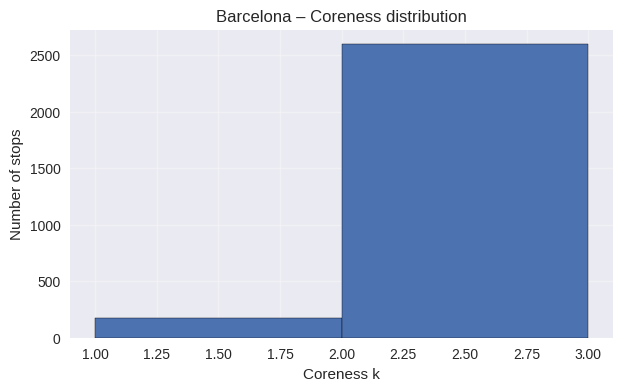

Milan: k_max = 3, nodes = 4,913


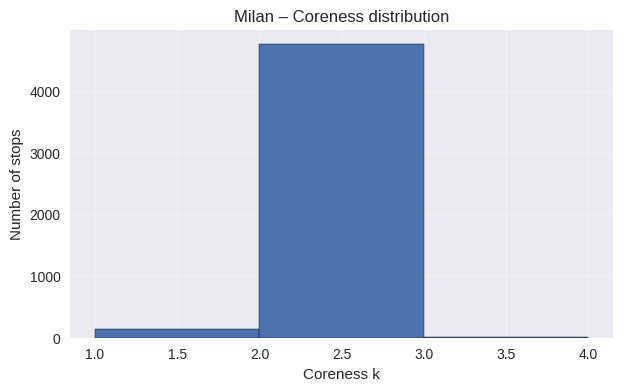

In [ ]:
def compute_core_numbers_nx(G, city_name=""):
    Gu = G.to_undirected()
    core_num = nx.core_number(Gu)   # NetworkX method required by you
    nx.set_node_attributes(G, core_num, "core_number")

    kmax = max(core_num.values()) if core_num else 0
    print(f"{city_name}: k_max = {kmax}, nodes = {G.number_of_nodes():,}")

    # distribution plot (for report)
    vals = np.array(list(core_num.values()))
    plt.figure(figsize=(7,4))
    plt.hist(vals, bins=range(int(vals.min()), int(vals.max())+2), edgecolor="black")
    plt.title(f"{city_name} – Coreness distribution")
    plt.xlabel("Coreness k"); plt.ylabel("Number of stops")
    plt.grid(True, alpha=0.3)
    plt.show()

    return core_num, kmax

core_barcelona, kmax_barcelona = compute_core_numbers_nx(G_barcelona, "Barcelona")
core_milan, kmax_milan = compute_core_numbers_nx(G_milan, "Milan")


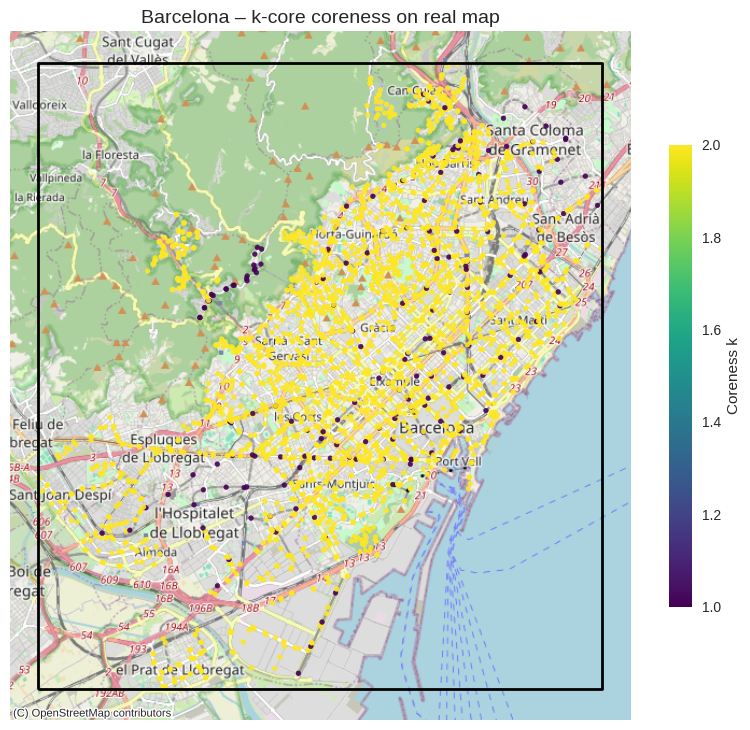

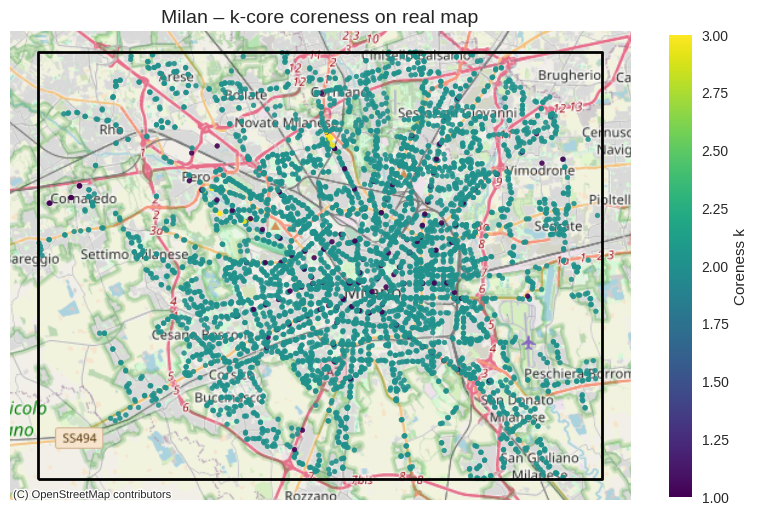

In [ ]:
import geopandas as gpd
import contextily as ctx
from shapely.geometry import Point

def plot_coreness_real_map(G, boundary_shp_path, city_name=""):
    rows = []
    for n, attrs in G.nodes(data=True):
        try:
            lon = float(attrs["stop_lon"])
            lat = float(attrs["stop_lat"])
            k = attrs.get("core_number", 0)
            rows.append((n, k, Point(lon, lat)))
        except:
            pass

    stops_gdf = gpd.GeoDataFrame(
        rows, columns=["stop_id", "core_number", "geometry"], crs="EPSG:4326"
    )

    boundary = gpd.read_file(boundary_shp_path)
    if boundary.crs is None:
        boundary = boundary.set_crs("EPSG:4326")

    stops_3857 = stops_gdf.to_crs(epsg=3857)
    boundary_3857 = boundary.to_crs(epsg=3857)
    stops_3857 = gpd.clip(stops_3857, boundary_3857)

    fig, ax = plt.subplots(figsize=(10,10))
    boundary_3857.boundary.plot(ax=ax, color="black", linewidth=2)

    stops_3857.plot(
        ax=ax,
        column="core_number",
        cmap="viridis",
        markersize=12,
        alpha=0.9,
        legend=True,
        legend_kwds={"shrink":0.6, "label":"Coreness k"}
    )

    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title(f"{city_name} – k-core coreness on real map", fontsize=14)
    ax.set_axis_off()
    plt.show()

    return stops_3857


barcelona_boundary_path = "/content/drive/MyDrive/SNA_Project/shapefiles/barcelona_boundary.shp"
milan_boundary_path     = "/content/drive/MyDrive/SNA_Project/shapefiles/milan_boundary.shp"

stops_barcelona_coremap = plot_coreness_real_map(G_barcelona, barcelona_boundary_path, "Barcelona")
stops_milan_coremap     = plot_coreness_real_map(G_milan, milan_boundary_path, "Milan")


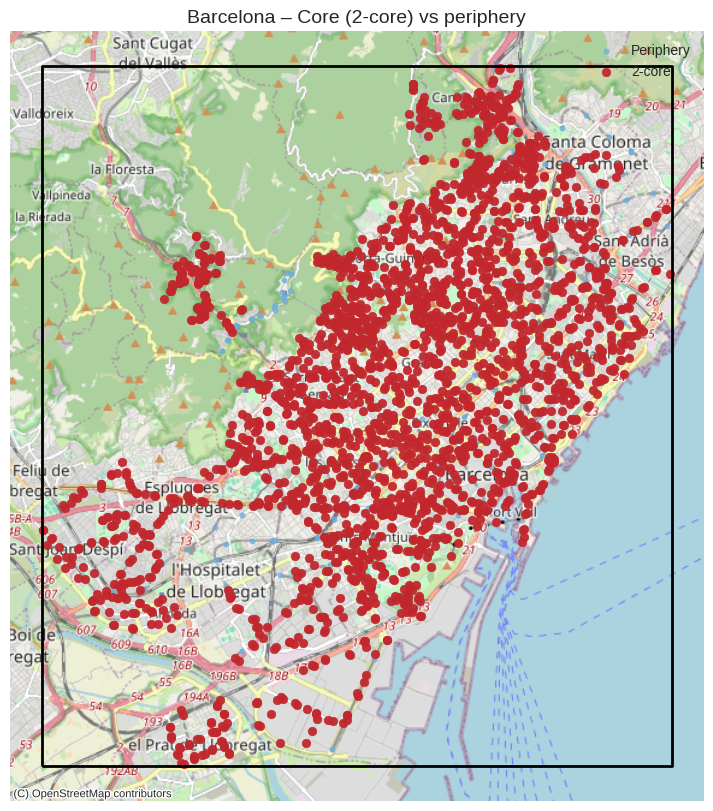

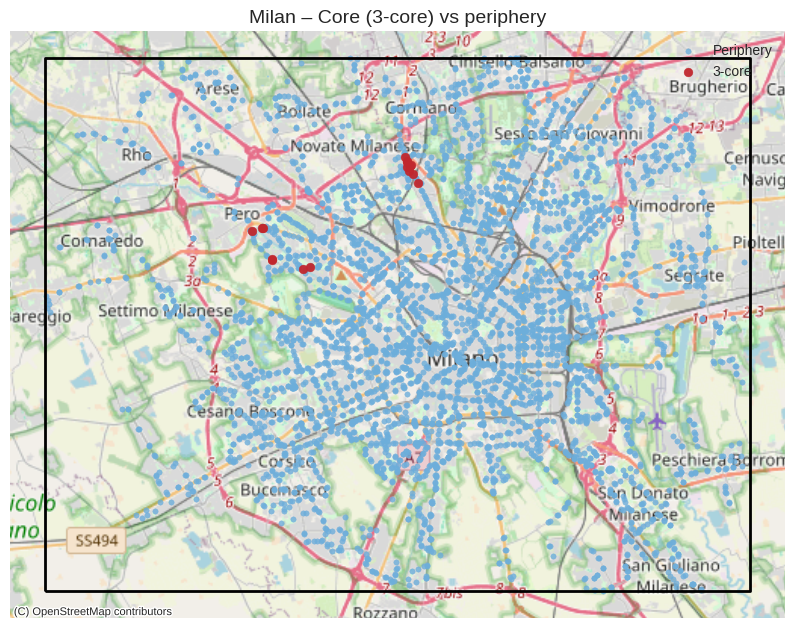

In [ ]:
def plot_core_periphery_real_map(G, boundary_shp_path, city_name=""):
    core_num = nx.get_node_attributes(G, "core_number")
    k_max = max(core_num.values())

    core_nodes = {n for n, k in core_num.items() if k == k_max}

    rows = []
    for n, attrs in G.nodes(data=True):
        try:
            lon = float(attrs["stop_lon"])
            lat = float(attrs["stop_lat"])
            is_core = 1 if n in core_nodes else 0
            rows.append((n, is_core, Point(lon, lat)))
        except:
            pass

    stops_gdf = gpd.GeoDataFrame(
        rows, columns=["stop_id", "is_core", "geometry"], crs="EPSG:4326"
    )

    boundary = gpd.read_file(boundary_shp_path)
    if boundary.crs is None:
        boundary = boundary.set_crs("EPSG:4326")

    stops_3857 = stops_gdf.to_crs(epsg=3857)
    boundary_3857 = boundary.to_crs(epsg=3857)
    stops_3857 = gpd.clip(stops_3857, boundary_3857)

    fig, ax = plt.subplots(figsize=(10,10))
    boundary_3857.boundary.plot(ax=ax, color="black", linewidth=2)

    # CLEAR PERIPHERY COLOR
    periphery_color = "#6DAEDB"   #  blue
    core_color = "#C1272D"        #  red

    stops_3857[stops_3857["is_core"]==0].plot(
        ax=ax,
        color=periphery_color,
        markersize=15,
        alpha=0.8,
        label="Periphery"
    )

    stops_3857[stops_3857["is_core"]==1].plot(
        ax=ax,
        color=core_color,
        markersize=40,
        alpha=0.95,
        label=f"{k_max}-core"
    )

    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.legend()
    ax.set_title(f"{city_name} – Core ({k_max}-core) vs periphery", fontsize=14)
    ax.set_axis_off()
    plt.show()



plot_core_periphery_real_map(G_barcelona, barcelona_boundary_path, "Barcelona")
plot_core_periphery_real_map(G_milan, milan_boundary_path, "Milan")


# Modularity

In [ ]:
from networkx.algorithms.community import greedy_modularity_communities
from networkx.algorithms.community.quality import modularity

def compute_greedy_modularity(G, city_name=""):
    Gu = G.to_undirected()

    # Greedy modularity communities (weighted)
    comms = list(greedy_modularity_communities(Gu, weight="weight"))
    Q = modularity(Gu, comms, weight="weight")

    print(f"{city_name}: communities={len(comms)} | modularity Q={Q:.4f}")

    # Save community labels to nodes
    comm_label = {}
    for i, c in enumerate(comms):
        for n in c:
            comm_label[n] = i

    nx.set_node_attributes(G, comm_label, "community")
    return comms, Q, comm_label


comms_barcelona, Q_barcelona, labels_barcelona = compute_greedy_modularity(G_barcelona, "Barcelona")
comms_milan, Q_milan, labels_milan = compute_greedy_modularity(G_milan, "Milan")


Barcelona: communities=40 | modularity Q=0.8901
Milan: communities=50 | modularity Q=0.9273


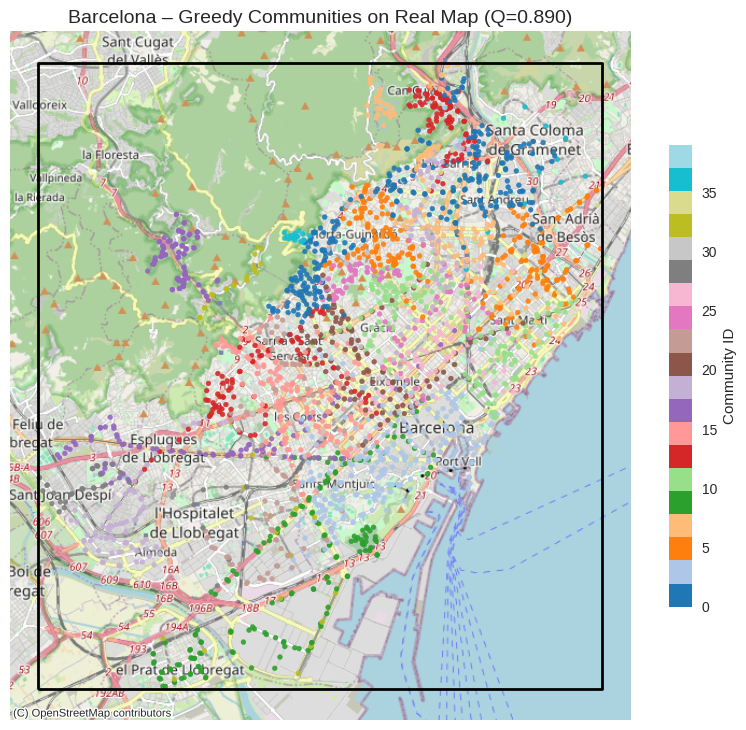

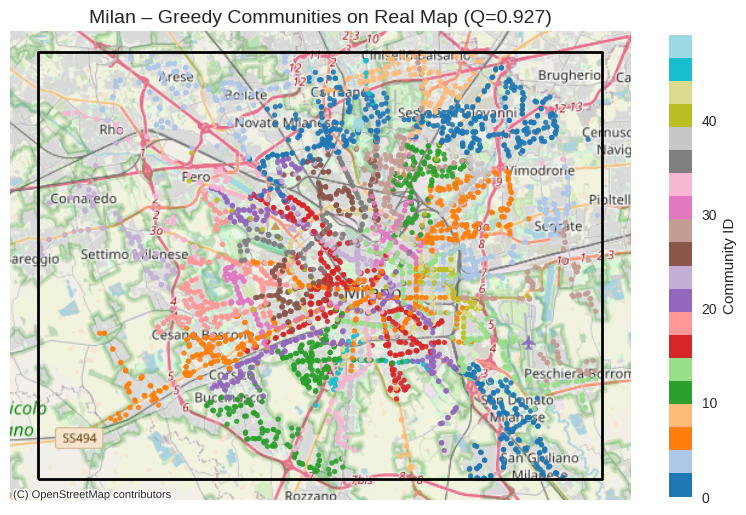

In [ ]:
def plot_greedy_communities_on_real_map(G, boundary_shp_path, Q, city_name=""):
    # ---- 1) Nodes -> GeoDataFrame (EPSG:4326) ----
    rows = []
    for n, attrs in G.nodes(data=True):
        try:
            lon = float(attrs["stop_lon"])
            lat = float(attrs["stop_lat"])
            comm = attrs.get("community", -1)
            rows.append((n, comm, Point(lon, lat)))
        except:
            pass

    stops_gdf = gpd.GeoDataFrame(
        rows, columns=["stop_id", "community", "geometry"], crs="EPSG:4326"
    )

    # ---- 2) Load boundary shapefile ----
    boundary = gpd.read_file(boundary_shp_path)
    if boundary.crs is None:
        boundary = boundary.set_crs("EPSG:4326")

    # ---- 3) Reproject to EPSG:3857 for basemap ----
    stops_3857 = stops_gdf.to_crs(epsg=3857)
    boundary_3857 = boundary.to_crs(epsg=3857)

    # ---- 4) Clip to city boundary ----
    stops_3857 = gpd.clip(stops_3857, boundary_3857)

    # ---- 5) Plot ----
    fig, ax = plt.subplots(figsize=(10, 10))

    boundary_3857.boundary.plot(ax=ax, linewidth=2, color="black")

    stops_3857.plot(
        ax=ax,
        column="community",
        cmap="tab20",
        markersize=12,
        alpha=0.9,
        legend=True,
        legend_kwds={"shrink": 0.6, "label": "Community ID"}
    )

    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

    ax.set_title(f"{city_name} – Greedy Communities on Real Map (Q={Q:.3f})", fontsize=14)

    ax.set_axis_off()
    plt.show()

    return stops_3857


barcelona_boundary_path = "/content/drive/MyDrive/SNA_Project/shapefiles/barcelona_boundary.shp"
milan_boundary_path     = "/content/drive/MyDrive/SNA_Project/shapefiles/milan_boundary.shp"

stops_barcelona_map = plot_greedy_communities_on_real_map(G_barcelona, barcelona_boundary_path, Q_barcelona, "Barcelona")
stops_milan_map     = plot_greedy_communities_on_real_map(G_milan, milan_boundary_path, Q_milan, "Milan")


# Assortativity

In [ ]:

# ASSORTATIVITY ANALYSIS

def compute_assortativity(G, city_name=""):
    print(f"\n--- Assortativity Analysis for {city_name} ---")


    r_degree = nx.degree_assortativity_coefficient(G)
    print(f"Degree Assortativity Coefficient (r): {r_degree:.4f}")

    if r_degree > 0:
        print("  -> Assortative: Hubs tend to connect to other hubs.")
    elif r_degree < 0:
        print("  -> Disassortative: Hubs tend to connect to smaller stops (Hub-and-Spoke pattern).")
    else:
        print("  -> Neutral network.")

    return r_degree


assort_barcelona = compute_assortativity(G_barcelona, "Barcelona")
assort_milan = compute_assortativity(G_milan, "Milan")


--- Assortativity Analysis for Barcelona ---
Degree Assortativity Coefficient (r): 0.1285
  -> Assortative: Hubs tend to connect to other hubs.

--- Assortativity Analysis for Milan ---
Degree Assortativity Coefficient (r): 0.1884
  -> Assortative: Hubs tend to connect to other hubs.


# Global Efficiency Analysis

In [ ]:

def calculate_global_efficiency(G, sample_size=None):

    print(f"\nTotal nodes in graph: {G.number_of_nodes():,}")
    print(f"Total edges in graph: {G.number_of_edges():,}")

    # Get largest connected component for meaningful analysis
    if G.is_directed():
        components = list(nx.weakly_connected_components(G))
        largest_cc = max(components, key=len)
        print(f"Number of weakly connected components: {len(components)}")
    else:
        components = list(nx.connected_components(G))
        largest_cc = max(components, key=len)
        print(f"Number of connected components: {len(components)}")

    G_cc = G.subgraph(largest_cc).copy()
    print(f"Largest component size: {len(G_cc.nodes())} nodes ({len(G_cc.nodes())/G.number_of_nodes()*100:.1f}% of total)")

    # Calculate efficiency for FULL GRAPH (all nodes)
    print("\n--- 1. FULL GRAPH Efficiency (all nodes including disconnected) ---")

    if sample_size and len(G.nodes()) > sample_size:
        all_nodes = np.random.choice(list(G.nodes()), size=sample_size, replace=False)
        print(f"Sampling {sample_size} nodes from full graph")
    else:
        all_nodes = list(G.nodes())
        print(f"Using all {len(all_nodes):,} nodes from full graph")

    full_total_efficiency = 0
    full_total_pairs = 0
    full_reachable_pairs = 0

    for source in tqdm(all_nodes, desc="Calculating full graph efficiency"):
        try:
            lengths = nx.single_source_shortest_path_length(G, source)

            for target in all_nodes:
                if source != target:
                    full_total_pairs += 1
                    if target in lengths:
                        length = lengths[target]
                        if length > 0:
                            full_total_efficiency += 1.0 / length
                            full_reachable_pairs += 1
        except:
            continue

    if full_total_pairs == 0:
        full_graph_efficiency = 0.0
    else:
        full_graph_efficiency = full_total_efficiency / full_total_pairs

    print(f"\n Full Graph Efficiency: {full_graph_efficiency:.6f}")
    print(f" Reachable pairs: {full_reachable_pairs:,} / {full_total_pairs:,} ({full_reachable_pairs/full_total_pairs*100:.1f}%)")

    # Calculate efficiency for LARGEST COMPONENT only
    print("\n--- 2. LARGEST COMPONENT Efficiency (main connected network) ---")

    if sample_size and len(G_cc.nodes()) > sample_size:
        cc_nodes = np.random.choice(list(G_cc.nodes()), size=sample_size, replace=False)
        print(f"Sampling {sample_size} nodes from largest component")
    else:
        cc_nodes = list(G_cc.nodes())
        print(f"Using all {len(cc_nodes):,} nodes from largest component")

    cc_total_efficiency = 0
    cc_total_pairs = 0
    cc_reachable_pairs = 0

    for source in tqdm(cc_nodes, desc="Calculating component efficiency"):
        try:
            lengths = nx.single_source_shortest_path_length(G_cc, source)

            for target in cc_nodes:
                if source != target:
                    cc_total_pairs += 1
                    if target in lengths:
                        length = lengths[target]
                        if length > 0:
                            cc_total_efficiency += 1.0 / length
                            cc_reachable_pairs += 1
        except:
            continue

    if cc_total_pairs == 0:
        component_efficiency = 0.0
    else:
        component_efficiency = cc_total_efficiency / cc_total_pairs

    print(f"\n Largest Component Efficiency: {component_efficiency:.6f}")
    print(f" Reachable pairs: {cc_reachable_pairs:,} / {cc_total_pairs:,} ({cc_reachable_pairs/cc_total_pairs*100:.1f}%)")

    # Calculate average shortest path lengths
    print("\n--- Summary Statistics ---")

    if full_reachable_pairs > 0:
        full_avg_path = full_reachable_pairs / full_total_efficiency
        print(f"Full Graph - Avg path length: {full_avg_path:.2f} hops")
    else:
        full_avg_path = None

    if cc_reachable_pairs > 0:
        cc_avg_path = cc_reachable_pairs / cc_total_efficiency
        print(f"Largest Component - Avg path length: {cc_avg_path:.2f} hops")
    else:
        cc_avg_path = None

    # Additional network metrics
    if G_cc.is_directed():
        strongly_connected = nx.is_strongly_connected(G_cc)
        print(f"Strongly connected: {strongly_connected}")

    return {
        'full_graph_efficiency': full_graph_efficiency,
        'component_efficiency': component_efficiency,
        'component_size': len(G_cc.nodes()),
        'component_percentage': len(G_cc.nodes())/G.number_of_nodes()*100,
        'full_avg_path': full_avg_path,
        'component_avg_path': cc_avg_path,
        'full_reachable_pct': full_reachable_pairs/full_total_pairs*100 if full_total_pairs > 0 else 0,
        'component_reachable_pct': cc_reachable_pairs/cc_total_pairs*100 if cc_total_pairs > 0 else 0,
        'full_reachable_pairs': full_reachable_pairs,
        'full_total_pairs': full_total_pairs,
        'component_reachable_pairs': cc_reachable_pairs,
        'component_total_pairs': cc_total_pairs
    }


In [ ]:
#Calculate Efficiency for Barcelona


print("Barcelona - Global Efficiency Analysis")
print("\n")

# Use ALL nodes for complete analysis
barcelona_efficiency_results = calculate_global_efficiency(G_barcelona, sample_size=None)


print("Barcelona - RESULTS SUMMARY")
print("\n")
print(f"Full Graph Efficiency:      {barcelona_efficiency_results['full_graph_efficiency']:.6f}")
print(f"   Reachable pairs:       {barcelona_efficiency_results['full_reachable_pct']:.1f}%")
print(f"  Avg path length:       {barcelona_efficiency_results['full_avg_path']:.2f} hops" if barcelona_efficiency_results['full_avg_path'] else "  └─ Avg path length:       N/A")
print()
print(f"Largest Component Efficiency: {barcelona_efficiency_results['component_efficiency']:.6f}")
print(f"  Component size:        {barcelona_efficiency_results['component_size']:,} nodes ({barcelona_efficiency_results['component_percentage']:.1f}%)")
print(f"  Reachable pairs:       {barcelona_efficiency_results['component_reachable_pct']:.1f}%")
print(f"  Avg path length:       {barcelona_efficiency_results['component_avg_path']:.2f} hops" if barcelona_efficiency_results['component_avg_path'] else "  └─ Avg path length:       N/A")


# Store the main efficiency values for later use
barcelona_global_eff = barcelona_efficiency_results['component_efficiency']  # Use component efficiency as primary metric
barcelona_full_eff = barcelona_efficiency_results['full_graph_efficiency']



Barcelona - Global Efficiency Analysis



Total nodes in graph: 2,771
Total edges in graph: 3,584
Number of weakly connected components: 12
Largest component size: 2492 nodes (89.9% of total)

--- 1. FULL GRAPH Efficiency (all nodes including disconnected) ---
Using all 2,771 nodes from full graph


Calculating full graph efficiency: 100%|██████████| 2771/2771 [00:03<00:00, 731.26it/s]



 Full Graph Efficiency: 0.032926
 Reachable pairs: 6,219,665 / 7,675,670 (81.0%)

--- 2. LARGEST COMPONENT Efficiency (main connected network) ---
Using all 2,492 nodes from largest component


Calculating component efficiency: 100%|██████████| 2492/2492 [00:04<00:00, 591.42it/s]


 Largest Component Efficiency: 0.040467
 Reachable pairs: 6,207,572 / 6,207,572 (100.0%)

--- Summary Statistics ---
Full Graph - Avg path length: 24.61 hops
Largest Component - Avg path length: 24.71 hops
Strongly connected: True
Barcelona - RESULTS SUMMARY


Full Graph Efficiency:      0.032926
   Reachable pairs:       81.0%
  Avg path length:       24.61 hops

Largest Component Efficiency: 0.040467
  Component size:        2,492 nodes (89.9%)
  Reachable pairs:       100.0%
  Avg path length:       24.71 hops


In [ ]:
#Calculate Efficiency for Milan

print("\n")
print("Milan - Global Efficiency Analysis")
print("\n")

# Use ALL nodes for complete analysis
milan_efficiency_results = calculate_global_efficiency(G_milan, sample_size=None)

print("\n")
print("Milan - RESULTS SUMMARY")
print("\n")
print(f"Full Graph Efficiency:      {milan_efficiency_results['full_graph_efficiency']:.6f}")
print(f"  Reachable pairs:       {milan_efficiency_results['full_reachable_pct']:.1f}%")
print(f"  Avg path length:       {milan_efficiency_results['full_avg_path']:.2f} hops" if milan_efficiency_results['full_avg_path'] else "  └─ Avg path length:       N/A")
print()
print(f"Largest Component Efficiency: {milan_efficiency_results['component_efficiency']:.6f}")
print(f"  Component size:        {milan_efficiency_results['component_size']:,} nodes ({milan_efficiency_results['component_percentage']:.1f}%)")
print(f"  Reachable pairs:       {milan_efficiency_results['component_reachable_pct']:.1f}%")
print(f"  Avg path length:       {milan_efficiency_results['component_avg_path']:.2f} hops" if milan_efficiency_results['component_avg_path'] else "  └─ Avg path length:       N/A")


# Store the main efficiency values for later use
milan_global_eff = milan_efficiency_results['component_efficiency']  # Use component efficiency as primary metric
milan_full_eff = milan_efficiency_results['full_graph_efficiency']




Milan - Global Efficiency Analysis



Total nodes in graph: 4,913
Total edges in graph: 6,118
Number of weakly connected components: 5
Largest component size: 4764 nodes (97.0% of total)

--- 1. FULL GRAPH Efficiency (all nodes including disconnected) ---
Using all 4,913 nodes from full graph


Calculating full graph efficiency: 100%|██████████| 4913/4913 [00:20<00:00, 243.49it/s]



 Full Graph Efficiency: 0.028166
 Reachable pairs: 22,628,160 / 24,132,656 (93.8%)

--- 2. LARGEST COMPONENT Efficiency (main connected network) ---
Using all 4,764 nodes from largest component


Calculating component efficiency: 100%|██████████| 4764/4764 [00:16<00:00, 282.83it/s]


 Largest Component Efficiency: 0.029899
 Reachable pairs: 22,619,556 / 22,690,932 (99.7%)

--- Summary Statistics ---
Full Graph - Avg path length: 33.29 hops
Largest Component - Avg path length: 33.34 hops
Strongly connected: False


Milan - RESULTS SUMMARY


Full Graph Efficiency:      0.028166
  Reachable pairs:       93.8%
  Avg path length:       33.29 hops

Largest Component Efficiency: 0.029899
  Component size:        4,764 nodes (97.0%)
  Reachable pairs:       99.7%
  Avg path length:       33.34 hops


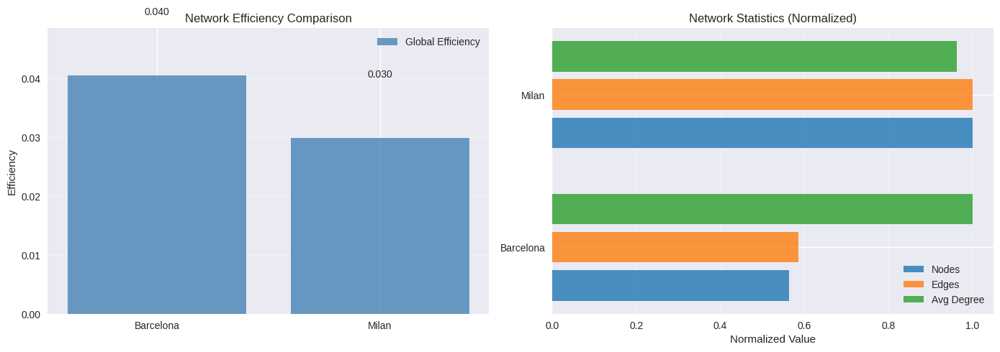

In [ ]:

# Comparative Visualization
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Global Efficiency Comparison
cities = ['Barcelona', 'Milan']
global_effs = [barcelona_global_eff, milan_global_eff]

x = np.arange(len(cities))

axes[0].bar(x, global_effs, label='Global Efficiency', color='steelblue', alpha=0.8)
axes[0].set_ylabel('Efficiency')
axes[0].set_title('Network Efficiency Comparison')
axes[0].set_xticks(x)
axes[0].set_xticklabels(cities)
axes[0].legend()
axes[0].grid(axis='y', alpha=0.3)
axes[0].set_ylim(0, max(global_effs) * 1.2)


for i, g in enumerate(global_effs):
    axes[0].text(i, g + 0.01, f'{g:.3f}', ha='center', va='bottom', fontsize=10)

# Network Statistics Comparison
stats_data = {
    'Nodes': [G_barcelona.number_of_nodes(), G_milan.number_of_nodes()],
    'Edges': [G_barcelona.number_of_edges(), G_milan.number_of_edges()],
    'Avg Degree': [
        sum(dict(G_barcelona.degree()).values()) / G_barcelona.number_of_nodes(),
        sum(dict(G_milan.degree()).values()) / G_milan.number_of_nodes()
    ]
}

x_pos = np.arange(len(cities))
colors = ['#1f77b4', '#ff7f0e', '#2ca02c']

for idx, (stat_name, values) in enumerate(stats_data.items()):
    normalized_values = [v / max(values) for v in values]
    axes[1].barh([i + idx*0.25 for i in x_pos], normalized_values,
                 height=0.2, label=stat_name, color=colors[idx], alpha=0.8)

axes[1].set_yticks([i + 0.25 for i in x_pos])
axes[1].set_yticklabels(cities)
axes[1].set_xlabel('Normalized Value')
axes[1].set_title('Network Statistics (Normalized)')
axes[1].legend()
axes[1].grid(axis='x', alpha=0.3)

plt.tight_layout()
plt.show()


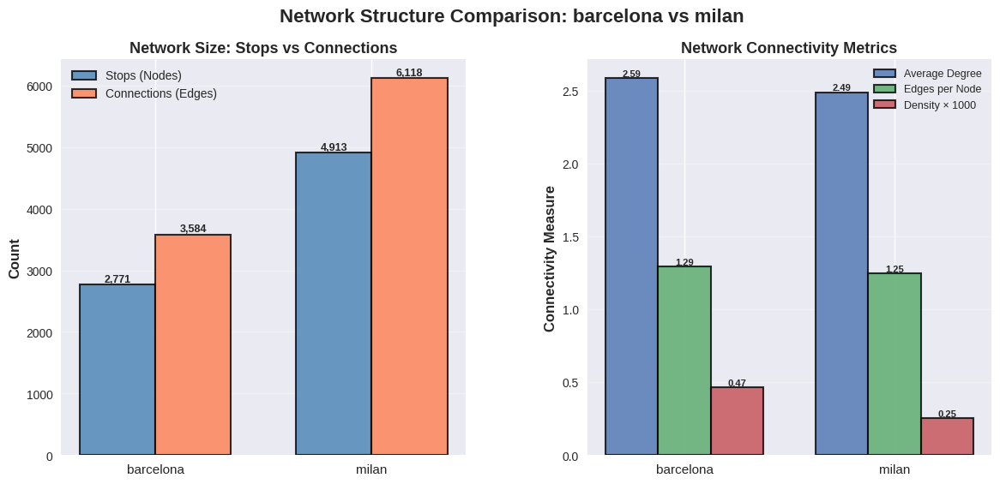

In [ ]:
# Additional Visualizations - Network Characteristics

fig = plt.figure(figsize=(14, 6))
gs = fig.add_gridspec(1, 2, hspace=0.3, wspace=0.3)

cities_list = ['barcelona', 'milan']
colors_map = ['steelblue', 'coral']

#Chart 1: Network Size Comparison
ax1 = fig.add_subplot(gs[0, 0])
nodes_count = [G_barcelona.number_of_nodes(), G_milan.number_of_nodes()]
edges_count = [G_barcelona.number_of_edges(), G_milan.number_of_edges()]

x = np.arange(len(cities_list))
width = 0.35

bars1 = ax1.bar(x - width/2, nodes_count, width, label='Stops (Nodes)',
                color='steelblue', alpha=0.8, edgecolor='black', linewidth=1.5)
bars2 = ax1.bar(x + width/2, edges_count, width, label='Connections (Edges)',
                color='coral', alpha=0.8, edgecolor='black', linewidth=1.5)

ax1.set_ylabel('Count', fontsize=12, fontweight='bold')
ax1.set_title('Network Size: Stops vs Connections', fontsize=13, fontweight='bold')
ax1.set_xticks(x)
ax1.set_xticklabels(cities_list, fontsize=11)
ax1.legend(fontsize=10)
ax1.grid(axis='y', alpha=0.3)


for bars in [bars1, bars2]:
    for bar in bars:
        height = bar.get_height()
        ax1.text(bar.get_x() + bar.get_width()/2., height,
                 f'{int(height):,}',
                 ha='center', va='bottom', fontsize=9, fontweight='bold')

#Chart 2: Network Connectivity Metrics
ax3 = fig.add_subplot(gs[0, 1])

# Calculate various connectivity metrics
avg_degree_barcelona = sum(dict(G_barcelona.degree()).values()) / G_barcelona.number_of_nodes()
avg_degree_milan = sum(dict(G_milan.degree()).values()) / G_milan.number_of_nodes()

edges_per_node_barcelona = G_barcelona.number_of_edges() / G_barcelona.number_of_nodes()
edges_per_node_milan = G_milan.number_of_edges() / G_milan.number_of_nodes()

connectivity_data = {
    'Average Degree': [avg_degree_barcelona, avg_degree_milan],
    'Edges per Node': [edges_per_node_barcelona, edges_per_node_milan],
    'Density × 1000': [nx.density(G_barcelona) * 1000, nx.density(G_milan) * 1000]
}

x = np.arange(len(cities_list))
width = 0.25
multiplier = 0

for attribute, measurement in connectivity_data.items():
    offset = width * multiplier
    bars = ax3.bar(x + offset, measurement, width, label=attribute,
                   alpha=0.8, edgecolor='black', linewidth=1.5)


    for bar in bars:
        height = bar.get_height()
        ax3.text(bar.get_x() + bar.get_width()/2., height,
                 f'{height:.2f}',
                 ha='center', va='bottom', fontsize=8, fontweight='bold')

    multiplier += 1

ax3.set_ylabel('Connectivity Measure', fontsize=12, fontweight='bold')
ax3.set_title('Network Connectivity Metrics', fontsize=13, fontweight='bold')
ax3.set_xticks(x + width)
ax3.set_xticklabels(cities_list, fontsize=11)
ax3.legend(fontsize=9)
ax3.grid(axis='y', alpha=0.3)

plt.suptitle('Network Structure Comparison: barcelona vs milan',
             fontsize=16, fontweight='bold', y=0.98)

plt.show()



# Average Path Length

In [ ]:

def compute_average_path_length(G, city_name="", sample_size=None):

    print(f"\n")
    print(f"Computing Average Path Length for {city_name}")
    print("\n")

    # Get largest strongly connected component
    if G.is_directed():
        largest_scc = max(nx.strongly_connected_components(G), key=len)
        G_scc = G.subgraph(largest_scc).copy()
        print(f"Largest Strongly Connected Component: {len(largest_scc)} nodes")
        print(f"  ({100*len(largest_scc)/G.number_of_nodes():.1f}% of total)")
    else:
        largest_cc = max(nx.connected_components(G), key=len)
        G_scc = G.subgraph(largest_cc).copy()
        print(f"Largest Connected Component: {len(largest_cc)} nodes")

    # Determine if we should sample
    n_nodes = G_scc.number_of_nodes()
    if sample_size is None:
        if n_nodes > 1000:
            sample_size = min(500, n_nodes // 2)
            print(f"\nLarge graph detected. Using sample of {sample_size} nodes.")
        else:
            sample_size = n_nodes
            print(f"\nComputing exact path lengths for all {n_nodes} nodes.")

    # Sample nodes if needed
    if sample_size < n_nodes:
        sampled_nodes = np.random.choice(list(G_scc.nodes()), size=sample_size, replace=False)
    else:
        sampled_nodes = list(G_scc.nodes())

    # Compute shortest paths
    all_path_lengths = []
    path_length_dict = {}

    print("\nComputing shortest paths...")
    for source in tqdm(sampled_nodes):
        try:
            lengths = nx.single_source_shortest_path_length(G_scc, source)
            for target, length in lengths.items():
                if source != target:
                    all_path_lengths.append(length)
                    if source not in path_length_dict:
                        path_length_dict[source] = []
                    path_length_dict[source].append(length)
        except:
            continue

    # Calculate statistics
    if all_path_lengths:
        avg_path_length = np.mean(all_path_lengths)
        median_path_length = np.median(all_path_lengths)
        std_path_length = np.std(all_path_lengths)
        max_path_length = np.max(all_path_lengths)
        min_path_length = np.min(all_path_lengths)
        diameter = max_path_length

        print(f"\nPath Length Statistics:")
        print(f"  Average Path Length: {avg_path_length:.4f}")
        print(f"  Median Path Length: {median_path_length:.4f}")
        print(f"  Std Dev: {std_path_length:.4f}")
        print(f"  Min: {min_path_length}")
        print(f"  Max: {max_path_length}")
        print(f"  Network Diameter: {diameter}")

        efficiency = 1.0 / avg_path_length if avg_path_length > 0 else 0
        print(f"  Network Efficiency: {efficiency:.4f}")

        results = {
            'avg_path_length': avg_path_length,
            'median_path_length': median_path_length,
            'std_path_length': std_path_length,
            'min_path_length': min_path_length,
            'max_path_length': max_path_length,
            'diameter': diameter,
            'efficiency': efficiency,
            'all_path_lengths': all_path_lengths,
            'path_length_dict': path_length_dict,
            'scc_size': len(largest_scc) if G.is_directed() else len(largest_cc)
        }

        return results
    else:
        print("Warning: Could not compute path lengths!")
        return None


def compare_path_lengths(results_b, results_m):
    """
    Compare path length metrics between two cities.
    ONLY COMPARATIVE PLOTS - No individual city plots.
    """
    fig, axes = plt.subplots(2, 2, figsize=(14, 10))

    # 1. Bar chart comparison of key metrics
    ax1 = axes[0, 0]
    metrics = ['Avg Path\nLength', 'Median', 'Diameter', 'Efficiency']
    barcelona_vals = [
        results_b['avg_path_length'],
        results_b['median_path_length'],
        results_b['diameter'],
        results_b['efficiency']
    ]
    milan_vals = [
        results_m['avg_path_length'],
        results_m['median_path_length'],
        results_m['diameter'],
        results_m['efficiency']
    ]

    x = np.arange(len(metrics))
    width = 0.35

    ax1.bar(x - width/2, barcelona_vals, width, label='Barcelona', alpha=0.8)
    ax1.bar(x + width/2, milan_vals, width, label='Milan', alpha=0.8)
    ax1.set_ylabel('Value')
    ax1.set_title('Path Length Metrics Comparison')
    ax1.set_xticks(x)
    ax1.set_xticklabels(metrics)
    ax1.legend()
    ax1.grid(True, alpha=0.3, axis='y')

    # 2. Overlapping histograms
    ax2 = axes[0, 1]
    ax2.hist(results_b['all_path_lengths'], bins=30, alpha=0.5,
            label='Barcelona', edgecolor='black')
    ax2.hist(results_m['all_path_lengths'], bins=30, alpha=0.5,
            label='Milan', edgecolor='black')
    ax2.set_xlabel('Path Length')
    ax2.set_ylabel('Frequency')
    ax2.set_title('Path Length Distribution Comparison')
    ax2.legend()
    ax2.grid(True, alpha=0.3)

    # 3. CDF comparison
    ax3 = axes[1, 0]
    sorted_b = np.sort(results_b['all_path_lengths'])
    sorted_m = np.sort(results_m['all_path_lengths'])
    cdf_b = np.arange(1, len(sorted_b) + 1) / len(sorted_b)
    cdf_m = np.arange(1, len(sorted_m) + 1) / len(sorted_m)

    ax3.plot(sorted_b, cdf_b, label='Barcelona', linewidth=2)
    ax3.plot(sorted_m, cdf_m, label='Milan', linewidth=2)
    ax3.set_xlabel('Path Length')
    ax3.set_ylabel('Cumulative Probability')
    ax3.set_title('Cumulative Distribution Comparison')
    ax3.legend()
    ax3.grid(True, alpha=0.3)

    # 4. Box plot comparison
    ax4 = axes[1, 1]
    data_to_plot = [results_b['all_path_lengths'], results_m['all_path_lengths']]
    ax4.boxplot(data_to_plot, labels=['Barcelona', 'Milan'])

    ax4.set_ylabel('Path Length')
    ax4.set_title('Path Length Distribution Comparison')
    ax4.grid(True, alpha=0.3, axis='y')

    plt.tight_layout()
    plt.show()


def create_summary_table(results_b, results_m):
    """Create a summary table comparing both networks."""
    summary_data = {
        'Metric': [
            'Average Path Length',
            'Median Path Length',
            'Std Dev',
            'Network Diameter',
            'Network Efficiency',
            'SCC Size (nodes)',
            'Min Path Length',
            'Max Path Length'
        ],
        'Barcelona': [
            f"{results_b['avg_path_length']:.4f}",
            f"{results_b['median_path_length']:.4f}",
            f"{results_b['std_path_length']:.4f}",
            f"{results_b['diameter']}",
            f"{results_b['efficiency']:.4f}",
            f"{results_b['scc_size']}",
            f"{results_b['min_path_length']}",
            f"{results_b['max_path_length']}"
        ],
        'Milan': [
            f"{results_m['avg_path_length']:.4f}",
            f"{results_m['median_path_length']:.4f}",
            f"{results_m['std_path_length']:.4f}",
            f"{results_m['diameter']}",
            f"{results_m['efficiency']:.4f}",
            f"{results_m['scc_size']}",
            f"{results_m['min_path_length']}",
            f"{results_m['max_path_length']}"
        ]
    }

    df_summary = pd.DataFrame(summary_data)
    print("\n" + "="*70)
    print("SUMMARY TABLE - Path Length Comparison")
    print("="*70)
    print(df_summary.to_string(index=False))
    print("="*70)

    return df_summary


AVERAGE PATH LENGTH ANALYSIS


Computing Average Path Length for Barcelona


Largest Strongly Connected Component: 2492 nodes
  (89.9% of total)

Computing shortest paths...


100%|██████████| 500/500 [00:01<00:00, 437.75it/s]



Path Length Statistics:
  Average Path Length: 30.7444
  Median Path Length: 29.0000
  Std Dev: 12.7019
  Min: 1
  Max: 111
  Network Diameter: 111
  Network Efficiency: 0.0325


Computing Average Path Length for Milan


Largest Strongly Connected Component: 4749 nodes
  (96.7% of total)

Computing shortest paths...


100%|██████████| 500/500 [00:02<00:00, 223.22it/s]



Path Length Statistics:
  Average Path Length: 40.1435
  Median Path Length: 39.0000
  Std Dev: 14.0017
  Min: 1
  Max: 116
  Network Diameter: 116
  Network Efficiency: 0.0249


/tmp/ipython-input-490383177.py:155: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax4.boxplot(data_to_plot, labels=['Barcelona', 'Milan'])


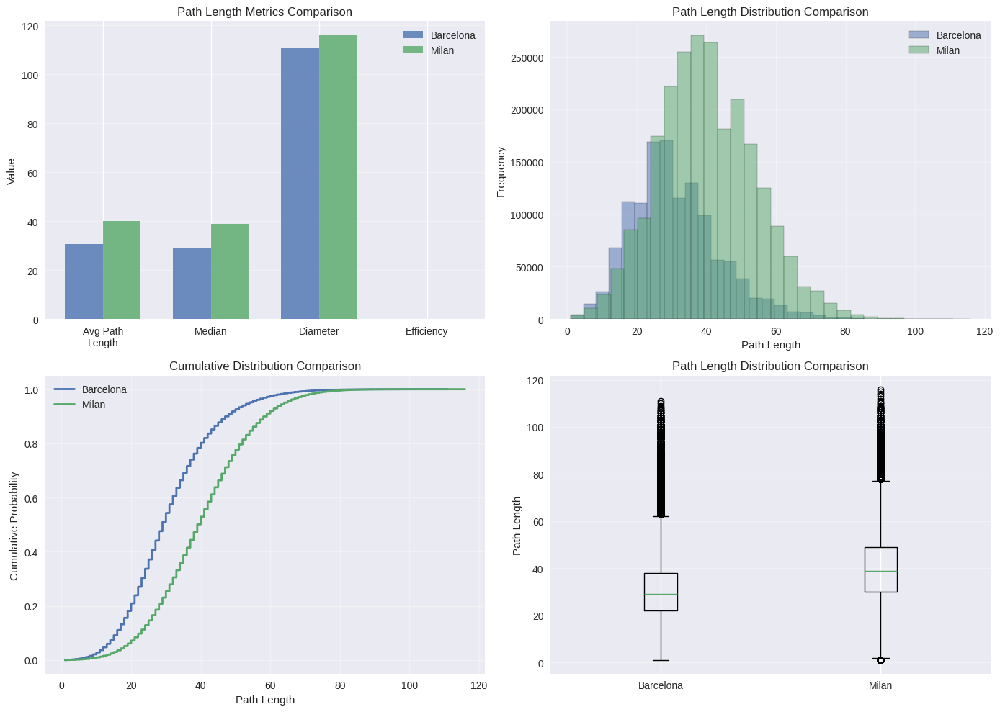


SUMMARY TABLE - Path Length Comparison
             Metric Barcelona   Milan
Average Path Length   30.7444 40.1435
 Median Path Length   29.0000 39.0000
            Std Dev   12.7019 14.0017
   Network Diameter       111     116
 Network Efficiency    0.0325  0.0249
   SCC Size (nodes)      2492    4749
    Min Path Length         1       1
    Max Path Length       111     116


In [ ]:

print("AVERAGE PATH LENGTH ANALYSIS")


# Compute average path lengths (using sampling for efficiency)
results_barcelona = compute_average_path_length(G_barcelona, "Barcelona", sample_size=500)
results_milan = compute_average_path_length(G_milan, "Milan", sample_size=500)

# ONLY comparative plots - no individual city plots
if results_barcelona and results_milan:
    compare_path_lengths(results_barcelona, results_milan)

    # Create summary table
    summary_df = create_summary_table(results_barcelona, results_milan)




# Robustness

In [ ]:
def largest_cc_fraction(Gu, n0):
    """fraction of nodes in largest connected component"""
    if Gu.number_of_nodes() == 0:
        return 0.0
    lcc = max(nx.connected_components(Gu), key=len)
    return len(lcc) / n0


def robustness_curve_random(G, fractions=None, n_trials=30, seed=42):
    """
    Random node removal robustness.
    Returns:
      fractions, mean_curve, std_curve, auc_mean
    """
    rng = random.Random(seed)
    Gu0 = G.to_undirected()
    nodes0 = list(Gu0.nodes())
    n0 = len(nodes0)

    if fractions is None:
        fractions = np.linspace(0, 1, 51)  # 0%,2%,...,100%

    curves = []

    for t in range(n_trials):
        order = nodes0[:]  # copy
        rng.shuffle(order)

        Gu = Gu0.copy()
        S = [largest_cc_fraction(Gu, n0)]

        removed = 0
        for f in fractions[1:]:
            target_remove = int(round(f * n0))
            while removed < target_remove and len(order) > 0:
                v = order.pop()
                if Gu.has_node(v):
                    Gu.remove_node(v)
                    removed += 1
            S.append(largest_cc_fraction(Gu, n0))

        curves.append(S)

    curves = np.array(curves)
    mean_curve = curves.mean(axis=0)
    std_curve = curves.std(axis=0)

    auc_mean = np.trapz(mean_curve, fractions)  # area under curve

    return fractions, mean_curve, std_curve, auc_mean


def robustness_curve_targeted(G, metric="degree", fractions=None, recompute=False):
    """
    Targeted node removal robustness.
    metric: "degree" or "betweenness" or "core"
    recompute:
       False -> compute ranking once at start (fast, standard attack in SNA)
       True  -> recompute metric after each batch removal (slower, adaptive attack)

    Returns:
      fractions, curve, auc
    """
    Gu0 = G.to_undirected()
    nodes0 = list(Gu0.nodes())
    n0 = len(nodes0)

    if fractions is None:
        fractions = np.linspace(0, 1, 51)

    def compute_scores(Gu):
        if metric == "degree":
            return dict(Gu.degree())
        elif metric == "betweenness":
            return nx.betweenness_centrality(Gu, weight="weight", normalized=True)
        elif metric == "core":
            return nx.core_number(Gu)
        else:
            raise ValueError("metric must be 'degree', 'betweenness', or 'core'")

    Gu = Gu0.copy()
    S = [largest_cc_fraction(Gu, n0)]
    removed = 0

    # initial ranking
    scores = compute_scores(Gu)
    order = sorted(scores, key=scores.get, reverse=True)

    for f in fractions[1:]:
        target_remove = int(round(f * n0))
        while removed < target_remove and len(order) > 0:
            v = order.pop(0)
            if Gu.has_node(v):
                Gu.remove_node(v)
                removed += 1

        if recompute and Gu.number_of_nodes() > 0:
            scores = compute_scores(Gu)
            order = sorted(scores, key=scores.get, reverse=True)

        S.append(largest_cc_fraction(Gu, n0))

    auc = np.trapz(S, fractions)
    return fractions, np.array(S), auc


In [ ]:
fractions = np.linspace(0, 1, 51)

# ---------- Barcelona ----------
f_b, rand_b_mean, rand_b_std, rand_b_auc = robustness_curve_random(
    G_barcelona, fractions=fractions, n_trials=30, seed=42
)

f_b, targ_deg_b, targ_deg_b_auc = robustness_curve_targeted(
    G_barcelona, metric="degree", fractions=fractions, recompute=False
)

f_b, targ_bet_b, targ_bet_b_auc = robustness_curve_targeted(
    G_barcelona, metric="betweenness", fractions=fractions, recompute=False
)

# ---------- Milan ----------
f_m, rand_m_mean, rand_m_std, rand_m_auc = robustness_curve_random(
    G_milan, fractions=fractions, n_trials=30, seed=42
)

f_m, targ_deg_m, targ_deg_m_auc = robustness_curve_targeted(
    G_milan, metric="degree", fractions=fractions, recompute=False
)

f_m, targ_bet_m, targ_bet_m_auc = robustness_curve_targeted(
    G_milan, metric="betweenness", fractions=fractions, recompute=False
)

print("\nROBUSTNESS AUC (higher = more robust)")
print(f"Barcelona random AUC:       {rand_b_auc:.3f}")
print(f"Barcelona targeted-degree:  {targ_deg_b_auc:.3f}")
print(f"Barcelona targeted-betw.:   {targ_bet_b_auc:.3f}")

print(f"\nMilan random AUC:           {rand_m_auc:.3f}")
print(f"Milan targeted-degree:      {targ_deg_m_auc:.3f}")
print(f"Milan targeted-betw.:       {targ_bet_m_auc:.3f}")


/tmp/ipython-input-3207671931.py:53: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  auc_mean = np.trapz(mean_curve, fractions)  # area under curve
/tmp/ipython-input-3207671931.py:108: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  auc = np.trapz(S, fractions)



ROBUSTNESS AUC (higher = more robust)
Barcelona random AUC:       0.205
Barcelona targeted-degree:  0.079
Barcelona targeted-betw.:   0.202

Milan random AUC:           0.184
Milan targeted-degree:      0.067
Milan targeted-betw.:       0.163


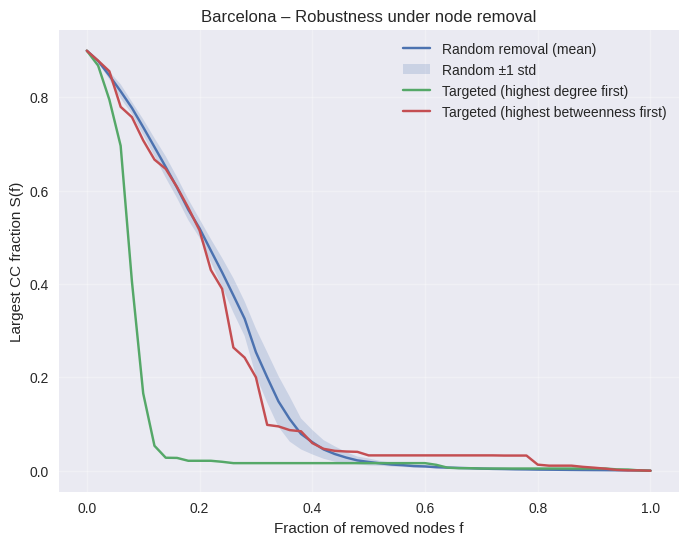

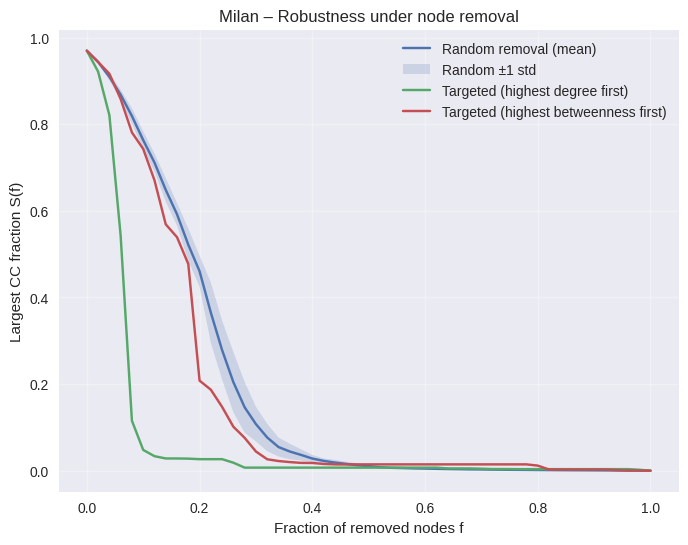

In [ ]:
def plot_robustness(fractions, rand_mean, rand_std, targ_deg, targ_bet, city_name=""):
    plt.figure(figsize=(8,6))

    # random removal with std band
    plt.plot(fractions, rand_mean, label="Random removal (mean)")
    plt.fill_between(
        fractions,
        rand_mean - rand_std,
        rand_mean + rand_std,
        alpha=0.2,
        label="Random ±1 std"
    )

    # targeted
    plt.plot(fractions, targ_deg, label="Targeted (highest degree first)")
    plt.plot(fractions, targ_bet, label="Targeted (highest betweenness first)")

    plt.xlabel("Fraction of removed nodes f")
    plt.ylabel("Largest CC fraction S(f)")
    plt.title(f"{city_name} – Robustness under node removal")
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.show()


plot_robustness(f_b, rand_b_mean, rand_b_std, targ_deg_b, targ_bet_b, "Barcelona")
plot_robustness(f_m, rand_m_mean, rand_m_std, targ_deg_m, targ_bet_m, "Milan")
